
# Embedding, Clustering & Annotation - Endocrine Cells
Michael Sterr

2021-06-09 14:38:16      


# Setup

Run following scripts before:
 * scRNA-seq_iPSC_IIR-KO_Embedding-Clustering-Annotation_S6-Only_All-Cells.ipynb

In [1]:
#from IPython.core.display import display, HTML
#display(HTML("<style>.container { width:85% !important; }</style>"))

In [1]:
# General
import scipy as sci
import numpy as np
import pandas as pd
import logging
import time
import pickle
from itertools import chain
import anndata as ad
import gc # Free memory #gc.collect()

#R
#import rpy2
#import rpy2.rinterface_lib.callbacks
#from rpy2.robjects import pandas2ri
#import anndata2ri

# # Plotting
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.colors as mcolors
from matplotlib import rcParams
from matplotlib import cm
import seaborn as sb
#from plotnine import *

# # Analysis
import scanpy as sc
import scanpy.external as sce
#import scvelo as scv
#import cellrank as cr

In [2]:
import rpy2
import rpy2.rinterface_lib.callbacks


In [3]:
# Settings

## Scanpy settings
sc.settings.verbosity = 3
#sc.logging.print_versions()

## Scanpy settings
#scv.settings.verbosity = 3
#scv.logging.print_versions()

## Cell Rank settings
#cr.settings.verbosity = 2

## R settings
### Ignore R warning messages
#### Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

### Automatically convert rpy2 outputs to pandas dataframes
#pandas2ri.activate()
#anndata2ri.activate()
#%load_ext rpy2.ipython

#pd.set_option('display.height', 1000)
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', 50)
#pd.set_option('display.width', 1000)

# Color Maps

In [4]:
from matplotlib.colors import ListedColormap
# Color maps4
#exec(open("/home/michi/Software/viscm/maps/michi_wt_rd_4.py").read())
#exec(open("/home/michi/Software/viscm/maps/dense.py").read())
#exec(open("/home/michi/Software/viscm/maps/turbo.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_bl_gn_yl.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_or.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_or_2.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_yl.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_yl_2.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_yl_3.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_yl_4.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_bl_gn.py").read())

ch_YlRd=sb.cubehelix_palette(100, start=.7, rot=.25, gamma=0.6, hue=2, light=1, dark=0.05, as_cmap=True)
ch_Bl=sb.cubehelix_palette(100, start=2.65, rot=0, gamma=0.8, hue=1.8, light=1, dark=0, as_cmap=True)
ch_Bl2=sb.cubehelix_palette(100, start=2.75, rot=-.12, gamma=0.8, hue=1.8, light=1, dark=0, as_cmap=True)
ch_Bl2_2=sb.cubehelix_palette(100, start=2.75, rot=-.12, gamma=0.8, hue=1.8, light=0.9, dark=0, as_cmap=True) #

cm_PuGy=ListedColormap(['#ededed', '#ecebec', '#eae9eb', '#e9e7eb', '#e8e5ea', '#e7e4e9', '#e5e2e8', '#e4e0e7', '#e3dee6', '#e1dce6', '#e0dae5', '#dfd8e4', '#ded7e3', '#dcd5e2', '#dbd3e1', '#dad1e1', '#d8cfe0', '#d7cddf', '#d6cbde', '#d5cadd', '#d3c8dc', '#d2c6dc', '#d1c4db', '#cfc2da', '#cec0d9', '#cdbfd8', '#ccbdd7', '#cabbd7', '#c9b9d6', '#c8b7d5', '#c6b5d4', '#c5b4d3', '#c4b2d2', '#c3b0d2', '#c1aed1', '#c0acd0', '#bfabcf', '#bda9ce', '#bca7cd', '#bba5cd', '#b9a3cc', '#b8a2cb', '#b7a0ca', '#b69ec9', '#b49cc8', '#b39ac8', '#b299c7', '#b097c6', '#af95c5', '#ae93c4', '#ac92c3', '#ab90c2', '#aa8ec2', '#a88cc1', '#a78bc0', '#a689bf', '#a487be', '#a385bd', '#a283bd', '#a182bc', '#9f80bb', '#9e7eba', '#9d7db9', '#9b7bb8', '#9a79b8', '#9977b7', '#9776b6', '#9674b5', '#9572b4', '#9370b3', '#926fb3', '#916db2', '#8f6bb1', '#8e69b0', '#8d68af', '#8b66ae', '#8a64ad', '#8863ad', '#8761ac', '#865fab', '#845daa', '#835ca9', '#825aa8', '#8058a8', '#7f57a7', '#7e55a6', '#7c53a5', '#7b52a4', '#7950a3', '#784ea2', '#774ca2', '#754ba1', '#7449a0', '#72479f', '#71469e', '#70449d', '#6e429d', '#6d409c', '#6b3f9b', '#6a3d9a'])
cm_YlBl=ListedColormap(['#ff7f0e', '#fe7f13', '#fc7f17', '#fb7f1a', '#fa7f1d', '#f87f20', '#f77f23', '#f57f26', '#f47f28', '#f37f2a', '#f17f2d', '#f07f2f', '#ee7f31', '#ed7f33', '#ec7f35', '#ea7f37', '#e97e39', '#e77e3b', '#e67e3d', '#e47e3e', '#e37e40', '#e27e42', '#e07e44', '#df7e45', '#dd7e47', '#dc7e49', '#da7e4a', '#d97e4c', '#d77e4e', '#d67e4f', '#d47e51', '#d37e52', '#d17e54', '#d07e55', '#ce7d57', '#cd7d59', '#cb7d5a', '#ca7d5c', '#c87d5d', '#c67d5f', '#c57d60', '#c37d62', '#c27d63', '#c07d64', '#be7d66', '#bd7d67', '#bb7d69', '#b97c6a', '#b87c6c', '#b67c6d', '#b47c6f', '#b37c70', '#b17c71', '#af7c73', '#ad7c74', '#ac7c76', '#aa7c77', '#a87c79', '#a67c7a', '#a47b7b', '#a37b7d', '#a17b7e', '#9f7b80', '#9d7b81', '#9b7b82', '#997b84', '#977b85', '#957b86', '#937b88', '#917a89', '#8e7a8b', '#8c7a8c', '#8a7a8d', '#887a8f', '#867a90', '#837a92', '#817a93', '#7e7a94', '#7c7996', '#797997', '#777998', '#74799a', '#71799b', '#6f799d', '#6c799e', '#69799f', '#6679a1', '#6278a2', '#5f78a3', '#5c78a5', '#5878a6', '#5478a8', '#5078a9', '#4c78aa', '#4878ac', '#4378ad', '#3d77ae', '#3777b0', '#3177b1', '#2977b3', '#1f77b4'])
cm_GnBl=ListedColormap(['#ffffff', '#fbfdfa', '#f7fcf6', '#f3faf2', '#eff8ef', '#ebf6eb', '#e7f4e8', '#e3f3e5', '#dff1e2', '#dbefde', '#d8eddb', '#d4ebd8', '#d0e9d5', '#cce7d2', '#c8e5cf', '#c5e3cf', '#c2e1ce', '#bfdfce', '#bcdccd', '#b9dacd', '#b6d8cd', '#b3d5cc', '#b0d3cb', '#add1cb', '#aaceca', '#a8ccca', '#a5cac9', '#a2c7c8', '#9fc5c8', '#9cc3c7', '#99c1c6', '#97bec5', '#94bcc5', '#91bac4', '#8eb7c3', '#8cb5c2', '#89b3c1', '#86b1c1', '#84aec0', '#81acbf', '#7eaabe', '#7ca7bd', '#79a5bc', '#77a3bb', '#74a1ba', '#729eb9', '#6f9cb8', '#6d9ab7', '#6a98b5', '#6895b4', '#6593b3', '#6391b2', '#608fb1', '#5e8db0', '#5c8aae', '#5988ad', '#5786ac', '#5584ab', '#5281a9', '#507fa8', '#4e7da7', '#4b7ba5', '#4979a4', '#4776a3', '#4574a1', '#4372a0', '#40709e', '#3e6e9d', '#3c6b9c', '#3a699a', '#386799', '#366597', '#346396', '#326194', '#305e92', '#2e5c91', '#2c5a8f', '#2a588e', '#28568c', '#26548b', '#245289', '#225087', '#204d86', '#1e4b84', '#1c4982', '#1a4781', '#18457f', '#16437d', '#14417b', '#123f7a', '#103d78', '#0e3b76', '#0c3974', '#0a3772', '#083571', '#06336f', '#04316d', '#032f6b', '#012d69', '#002a67'])
cm_Bl=ListedColormap(['#ffffff', '#fbfdfc', '#f7fbfb', '#f4f9f9', '#f0f7f8', '#ecf5f7', '#e9f3f5', '#e5f1f4', '#e2eff3', '#deedf2', '#daebf1', '#d7e9f0', '#d3e7ef', '#cfe5ee', '#cce3ed', '#c8e1ec', '#c4dfeb', '#c1ddea', '#bddbe9', '#b9d9e8', '#b6d7e7', '#b2d5e6', '#aed3e5', '#abd1e4', '#a7cfe3', '#a3cde2', '#9fcbe1', '#9cc8e0', '#9ac6df', '#97c4de', '#95c2dd', '#92bfdc', '#90bddb', '#8ebbda', '#8bb8d8', '#89b6d7', '#86b4d6', '#84b2d5', '#82afd4', '#7fadd2', '#7dabd1', '#7ba9d0', '#78a6cf', '#76a4cd', '#73a2cc', '#71a0cb', '#6f9ec9', '#6d9bc8', '#6a99c6', '#6897c5', '#6695c4', '#6393c2', '#6190c1', '#5f8ebf', '#5d8cbe', '#5a8abc', '#5888bb', '#5686b9', '#5483b8', '#5281b6', '#4f7fb5', '#4d7db3', '#4b7bb2', '#4979b0', '#4777ae', '#4575ad', '#4272ab', '#4070a9', '#3e6ea8', '#3c6ca6', '#3a6aa4', '#3868a3', '#3666a1', '#34649f', '#32629d', '#30609b', '#2e5e9a', '#2c5c98', '#2a5a96', '#285794', '#265592', '#245390', '#23518e', '#214f8c', '#1f4d8a', '#1d4b88', '#1b4986', '#1a4784', '#184582', '#164380', '#14417e', '#133f7c', '#113e7a', '#103c78', '#0e3a76', '#0d3874', '#0b3672', '#0a346f', '#09326d', '#08306b'])
cm_BlBk=ListedColormap(['#ffffff', '#fbfcfe', '#f6fafd', '#f2f7fc', '#eef4fa', '#eaf1f9', '#e6eff8', '#e1ecf6', '#dde9f5', '#d9e7f4', '#d5e4f2', '#d1e1f1', '#cddff0', '#c9dcee', '#c4d9ed', '#c0d7ec', '#bcd4ea', '#b8d1e9', '#b4cfe8', '#afcce6', '#abc9e5', '#a7c7e3', '#a3c4e2', '#9ec2e1', '#9abfdf', '#96bcde', '#91badc', '#8db7db', '#89b5da', '#84b2d8', '#80b0d7', '#7badd5', '#76aad4', '#72a8d2', '#6da5d1', '#68a3d0', '#63a0ce', '#5e9ecd', '#589bcb', '#5399ca', '#4d96c9', '#4794c7', '#4291c5', '#408ec3', '#3f8cc0', '#3e89bd', '#3c86bb', '#3b83b8', '#3a80b5', '#397db3', '#377bb0', '#3678ad', '#3575aa', '#3472a7', '#3270a4', '#316da2', '#306a9f', '#2f679c', '#2e6599', '#2d6296', '#2c5f93', '#2a5d90', '#295a8d', '#28588a', '#275586', '#265283', '#255080', '#244d7d', '#234b7a', '#234876', '#224673', '#214470', '#20416d', '#1f3f69', '#1e3c66', '#1e3a62', '#1d385f', '#1c355c', '#1b3358', '#1b3155', '#1a2e51', '#192c4d', '#182a4a', '#182846', '#172642', '#16233f', '#16213b', '#151f37', '#141d34', '#131b30', '#12192c', '#121728', '#111524', '#101320', '#0e101c', '#0c0d19', '#090a14', '#06070f', '#030308', '#000000'])
cm_CatBl=mcolors.ListedColormap(['#ffffff', '#fdfdfe', '#fbfcfd', '#f9fbfc', '#f7f9fb', '#f5f8fa', '#f3f6f9', '#f1f5f8', '#eff3f7', '#edf2f6', '#ebf0f5', '#e9eff4', '#e7edf3', '#e6ecf2', '#e4eaf1', '#e2e9f0', '#e0e7f0', '#dee6ef', '#dce4ee', '#dae3ed', '#d8e1ec', '#d6e0eb', '#d4deea', '#d2dde9', '#d0dbe8', '#cedae7', '#ccd9e6', '#cad7e5', '#c8d6e4', '#c6d4e3', '#c4d3e2', '#c2d1e1', '#c0d0e0', '#bfcedf', '#bdcdde', '#bbccdd', '#b9cadc', '#b7c9db', '#b5c7da', '#b3c6d9', '#b1c4d8', '#afc3d8', '#adc2d7', '#abc0d6', '#a9bfd5', '#a7bdd4', '#a5bcd3', '#a3bad2', '#a1b9d1', '#9fb8d0', '#9db6cf', '#9bb5ce', '#99b3cd', '#97b2cc', '#95b1cb', '#93afca', '#92aec9', '#90acc8', '#8eabc7', '#8caac6', '#8aa8c5', '#88a7c5', '#86a5c4', '#84a4c3', '#82a3c2', '#80a1c1', '#7ea0c0', '#7c9fbf', '#7a9dbe', '#779cbd', '#759abc', '#7399bb', '#7198ba', '#6f96b9', '#6d95b8', '#6b94b7', '#6992b6', '#6791b5', '#6590b5', '#638eb4', '#608db3', '#5e8cb2', '#5c8ab1', '#5a89b0', '#5888af', '#5586ae', '#5385ad', '#5184ac', '#4f82ab', '#4c81aa', '#4a80a9', '#477ea8', '#457da7', '#427ca7', '#407aa6', '#3d79a5', '#3b78a4', '#3877a3', '#3575a2', '#3274a1'])
cm_CatYl=mcolors.ListedColormap(['#ffffff', '#fffefd', '#fffcfb', '#fffbf8', '#fffaf6', '#fff9f4', '#fff7f2', '#fff6f0', '#fff5ee', '#fff3ec', '#fff2e9', '#fff1e7', '#ffefe5', '#ffeee3', '#ffede1', '#ffecde', '#ffeadc', '#ffe9da', '#ffe8d8', '#ffe6d6', '#ffe5d4', '#ffe4d1', '#ffe2cf', '#ffe1cd', '#ffe0cb', '#ffdec9', '#ffddc6', '#fedcc4', '#fedbc2', '#fed9c0', '#fed8be', '#fed7bc', '#fed5ba', '#fdd4b8', '#fdd3b5', '#fdd2b3', '#fdd0b1', '#fdcfaf', '#fccead', '#fcccab', '#fccba9', '#fccaa7', '#fbc9a5', '#fbc7a2', '#fbc6a0', '#fbc59e', '#fac39c', '#fac29a', '#fac198', '#f9c096', '#f9be94', '#f9bd92', '#f8bc90', '#f8bb8e', '#f8b98c', '#f7b889', '#f7b787', '#f6b685', '#f6b483', '#f6b381', '#f5b27f', '#f5b07d', '#f5af7b', '#f4ae79', '#f4ad77', '#f3ab75', '#f3aa73', '#f2a971', '#f2a86f', '#f1a66d', '#f1a56b', '#f1a468', '#f0a366', '#f0a164', '#efa062', '#ef9f60', '#ee9e5e', '#ee9c5c', '#ed9b5a', '#ed9a58', '#ec9956', '#ec9754', '#eb9652', '#ea9550', '#ea944d', '#e9924b', '#e99149', '#e89047', '#e88f45', '#e78d43', '#e68c41', '#e68b3e', '#e58a3c', '#e5883a', '#e48738', '#e38635', '#e38533', '#e28331', '#e2822e', '#e1812c'])

In [5]:
# Plot settings
%matplotlib inline

## Directory
#sc.settings.figdir='/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Figures'

## Plotting parameters
#rcParams['figure.figsize']=(20,20) #rescale figures
#sc.set_figure_params(scanpy=True, frameon=False, vector_friendly=False, color_map='tab10' ,transparent=True, dpi=150, dpi_save=300)
#sc.set_figure_params(scanpy=True, frameon=False, vector_friendly=False ,transparent=True, dpi=150, dpi_save=300)

## Font
#rcParams['font.family'] = 'sans-serif'
#rcParams['font.sans-serif'] = ['Source Sans 3']

## Grid & Ticks
#rcParams['grid.alpha'] = 0
#rcParams['xtick.bottom'] = True
#rcParams['ytick.left'] = True

## Embed font
#plt.rc('pdf', fonttype=42)

## Define new default settings
#plt.rcParamsDefault = plt.rcParams

sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=False,
                     color_map="YlGnBu", format='pdf', transparent=False,
                     ipython_format='png2x', figsize=(8,8))

# Load Data

In [6]:
adata=sc.read('/Users/dominik.klein/data/E14-E15_adata_filtered_rmDoublets_sctNormalized_WNN_embedded_initialAnno_intermediate.h5ad')

In [7]:
# Load cell cycle genes

## KEGG cell cycle genes
cc_kegg = pd.read_table('/Users/dominik.klein/Downloads/KEGG_mmu_Cell_Cycle.txt').iloc[:,0].tolist()

## Cell cycle genes Regev lab (Tirosh et al. 2016, DOI: 10.1126/science.aad0501)
cc_genes_regev = [x.strip() for x in open('//Users/dominik.klein/Downloads/regev_cell_cycle_genes.txt')]

s_genes_regev = [gene.lower().capitalize() for gene in cc_genes_regev[:43]]
g2m_genes_regev = [gene.lower().capitalize() for gene in cc_genes_regev[43:]]

cc_genes_regev = [gene.lower().capitalize() for gene in cc_genes_regev]

## Cell cycle genes Macosko et al. 2015, https://doi.org/10.1016/j.cell.2015.05.002
#cc_genes_macosko = pd.read_table('/mnt/ssd/Resources/Macosko_cell_cycle_genes.txt', delimiter='\t')

#s_genes_macosko = [gene.lower().capitalize() for gene in list(cc_genes_macosko['S'].dropna())]
#g2m_genes_macosko = [gene.lower().capitalize() for gene in list(cc_genes_macosko['G2.M'].dropna())]
#m_genes_macosko = [gene.lower().capitalize() for gene in list(cc_genes_macosko['M'].dropna())]
#mg1_genes_macosko = [gene.lower().capitalize() for gene in list(cc_genes_macosko['M.G1'].dropna())]
#g1s_genes_macosko = [gene.lower().capitalize() for gene in list(cc_genes_macosko['IG1.S'].dropna())]

#cc_genes_macosko = s_genes_macosko + g2m_genes_macosko + m_genes_macosko + mg1_genes_macosko + g1s_genes_macosko

## Combine all
all_cc_genes = list(set(cc_kegg + cc_genes_regev))# + cc_genes_macosko))

In [8]:
# Marker genes mouse pancreas (pair-wise)
marker_genes_mouse = dict()
marker_genes_mouse['Mat. Acinar'] = ['Arhgdig','Ass1','Cckar','Cel','Cela1','Cldn10','Dhx34','Edem1','Edem2','Erp27','Fkbp11','Gamt','Gcat','Gstm1','Mt1','Nupr1','Pnliprp1','Rbpjl','Reep5','Serpini2','Spink1','Tmem97']
marker_genes_mouse['Trunk'] = ['Actb']
marker_genes_mouse['Prlf. Trunk'] = ['H2afz']
marker_genes_mouse['Ngn3 high EP'] = ['Btbd17','Cbfa2t3','Cotl1','Gadd45a','Hes6','Mtch1','Neurog3','Ppp1r14a','Smarcd2','Tmsb4x']
marker_genes_mouse['Fev+'] = ['Fev', 'Krt7']
marker_genes_mouse['Beta'] = ['1110008P14Rik', 'Gng12', 'Mafb', 'Papss2']
marker_genes_mouse['Alpha'] = ['BC048546', 'Peg10', 'Slc38a5', 'Tmem27', 'Ttr', 'Tmsb15l']
marker_genes_mouse['Delta'] = ['Cd24a', 'Hhex', 'Pyy', 'Rbp4', 'Sst']
marker_genes_mouse['Epsilon'] = ['Ghrl', 'Maged2', 'Mboat4']
marker_genes_mouse['Multipotent'] = ['Npm1', 'Ppia']
marker_genes_mouse['Acinar'] = ['Car9','Cbs', 'Cckar','Cel','Cela1','Cldn10','Edem1','Erp27','Gamt','Gcat','Gstm1','Igf1','Nupr1','Ptf1a','Rbpjl','Reep5','Serpini2','Tmem97']
marker_genes_mouse['primary Alpha'] = ['Sct', 'Slc38a5']
#marker_genes_mouse[] = []

# Marker genes mouse pancreas unique versus rest
marker_genes_mouse2 = dict()
marker_genes_mouse2['Multipotent'] = ['Eef2', 'Rpl38', 'Rpl22', 'Rpl7a', 'Eef1b2', 'Btf3', 'Gnb2l1', 'Pabpc1']
marker_genes_mouse2['Tip'] = ['Smco4', 'Bzw2', 'Gcsh', 'Nme4', 'Cpn1', 'Mpp6', 'Gpc3', 'Tcf15', 'Capn6', 'Nop56', 'Trp53', 'Sdc1', 'Afp', 'Cdca7', 'Hyal2', 'Nrp1', 'P2rx1', 'Ccnd2', 'Jam3', 'Myc', 'Prss23', 'Ccdc30', 'Trf', 'Tnfaip8', 'Gulo', 'Dkc1', 'Fermt1', 'Vtn', 'Cda', 'Fbl', 'Zfp503', 'Rhov', 'Gsto1', 'Acvr2b', 'Noxa1', 'Id3', 'Apoe', 'Chst2', 'Ogfrl1', 'Sdpr', 'Nipsnap1', 'Ung', 'Hmgb3', 'Ruvbl1', 'Sez6', 'Igf2bp1', 'Igfbp4', 'Frem2', 'Flrt2', 'Dcakd', 'Mest', 'Cdca7l', 'Ppif', 'Dctd', 'Atic', 'Paics', 'Fbln1', 'Kirrel2', 'Rcbtb2', 'Gc', 'Dusp9', 'Car14', 'Hmga1-rs1', 'Hmga1', 'Phgdh', 'Gnl3', 'Stmn1', 'Dctpp1', 'Gar1', 'Matn4', 'Serf1', 'Rcn3', 'Ruvbl2', 'Sept9', 'Fzd2', 'Wdr77', 'Trim28', 'Pltp', 'Bmp7', 'Igfbp2', 'Shmt1', 'Crabp1', 'Mcm7', 'Etv4', 'Prdx6', 'Fam60a', 'Pcbp4', 'Apex1', 'C1qbp', 'Rcan2']
marker_genes_mouse2['Prlf. Tip'] = ['Cdca7l', 'Ccnf', 'Mpp6', 'Nasp', 'Cdca4', 'Eme1', 'Rad51ap1', 'Ncaph', 'Ezh2', 'Cdca5', 'Skp2', 'Vrk1', 'Exo1', 'Ube2t', 'Dut', 'Hist1h2ae', 'Trip13', 'Kif22', 'Cenpn', 'Rrm1', 'Fam64a', 'Kif2c', 'Dscc1', 'Mns1', 'Aars', 'Pcna', 'Mcm7', 'Cenpw', 'Fignl1', 'Rcc1', 'Clspn']
marker_genes_mouse2['Trunk'] = ['mt-Co2', 'H2afz', 'Notch2', 'Hmgn1', 'Hnrnpa1', 'Rpgrip1', 'mt-Co3', 'mt-Nd1']
marker_genes_mouse2['Prlf. Trunk'] = ['Supt16', 'Hmgn2', 'Sumo2', 'Ran', 'Ranbp1', 'Hmgn1', 'Dynll1', 'Hnrnpa1', 'Rpgrip1', 'H2afz', 'Anp32b']
marker_genes_mouse2['Prlf. Acinar'] = ['Pigf', 'Suclg2', 'Pla1a', 'Akr1c13', 'Ddc', 'Uchl5', 'Add3', 'Pa2g4', 'Gart', 'Gata4', 'Galk1', 'Lyar', 'Tinag', 'Vars', 'Gar1', 'Tex30', 'Wdtc1', 'Ifrd2', 'Mthfd1', 'Pold2', 'Atad3a', 'Phlda1', 'Ptn', 'Igf2', 'Umps', 'Aldh1b1', 'Slc38a3', 'Plk2', 'Akap7']
marker_genes_mouse2['Mat. Acinar'] = ['Try10', 'Clps', 'Tram1', 'C1qa', 'Ssr1', 'Prss1', 'Dap', 'Tspan13', 'Atp5g1', 'Bhlha15', 'Car9', 'Cela3b', 'Bcat2', 'Ldha', 'Arhgdig', 'Dhrs7', 'Rexo2', 'Ssr4', 'Ass1', 'Ppib', 'Ang', 'Lgals1', 'Tob1', 'Fabp5', 'Ttc23', 'Sel1l', 'Lin37', 'Tmed3', 'P4hb', 'Pdia2', 'Ostc', 'Herpud1', 'Dnajc3', 'Tmem147', 'Clu', 'Rap1gap', 'Rps27l', 'Kctd14', 'Fkbp2', 'Serp1', 'Mlec', 'Sephs2', 'Sdf2l1', 'Edem1', 'Edem2', 'Krtcap2', 'Aqp8', 'Sepp1', 'Tmem238', 'Try5', 'Dhx34', 'Msrb1', 'Bckdk', 'Fam46c', 'Erp27', 'Vimp', 'Mrps24', 'Rrbp1', 'Gm15915', 'Cpb1', 'Rnase4', 'Fkbp11', 'Cela2a', 'Prss2']
marker_genes_mouse2['Ductal'] = ['Hpgd', 'Rassf10', 'Fmo2', 'Ugt2b34', 'Cdc42ep1', 'Gm266', 'Fjx1', 'Trip6', 'Slco3a1', 'Cited1', 'Cadm1', 'Gpt2', 'Rhob', 'Rxrg', 'Igsf3', 'Sphk1', 'Fam89a', 'Ctsh', 'Nrarp', 'Mycn', 'Tubb2b', 'Nav2', 'Ajuba', 'Ncald', 'Akr1cl', 'Eno1', 'S100a16', 'Cnn3']
marker_genes_mouse2['Prlf. Ductal'] = ['Kif11', '2700094K13Rik', 'Dnajc9', 'Ccdc34', 'Cited1', 'Slco3a1', 'Cadm1', 'Melk', 'Kif23', 'Kif20a', 'Nuf2', 'Nrarp', 'Tuba1c', 'Bub3', 'Mki67', 'Asf1b', 'Mxd3']
marker_genes_mouse2['Ngn3 low EP'] = ['Gas2', 'Fndc5', 'Dbi', 'Fabp3', 'Ptprf', 'Cxcl12', 'Tmem171', 'Fam159a', 'Igf1r', 'Nrtn', 'Crp', 'Grin3a', 'Trim47', 'Mia', 'Enpp2', 'Ndrg2', 'Slc28a3', 'Lamb1', 'Kcnk1', 'Zfhx3', 'Eps8l2', 'Gal3st1', 'Mesdc1', 'Slc2a2', 'Ckb', 'Rbms3', 'Krt18', 'Wapl', 'Anxa5']
marker_genes_mouse2['Ngn3 High early'] = ['Spsb4', 'Kdm1a', 'Pard3', 'Gm8773', 'Fgd2', 'Rasl11b', 'Enc1', 'Tpm4', 'Gtf2a2', 'Agap3', 'Sox11', 'Phc2', 'Lrrn2', 'Glrx3', 'Csnk1e', 'Ssbp3', 'Ppp1r14b', 'Plk3', 'Chd7', 'Steap1']
marker_genes_mouse2['Ngn3 High late'] = ['Ly6e', 'Ifitm2', 'Swt1', 'Hspa8', 'Rnf114', 'Traf4', 'Shf', 'Tpst2', 'Sulf2', 'Sult2b1', '2010107G23Rik', 'Prdx2', 'Eif3f']
marker_genes_mouse2['Fev+ Beta'] = ['Nisch', 'Clta', 'Npepl1', 'Cox7a2l']
marker_genes_mouse2['Beta'] = ['Papss2', 'Ins2', 'Mien1', 'Ece1', 'Nnat', 'Mlxipl', 'Entpd3', 'Gjd2', 'Atp6v1e1', 'Pcsk1', 'Sec61b', 'Immp1l', 'Pdx1', 'Atp2a2', 'Ociad2']
marker_genes_mouse2['Fev+ Alpha'] = ['Cd164l2', 'Dst', 'Irf2bpl', 'Gm43861', 'Gnai2', 'Pnmal1', 'Klhl7', 'Tekt2', 'Qdpr', 'Zwint']
marker_genes_mouse2['primary Alpha'] = ['Dnajc12', 'Asb4', 'Uqcc2', 'Ptprn', 'Wnk3', 'Cd81', 'Ly6h', 'Emc10', 'Edn3', 'Slc14a2', 'Ndufv3', 'Atp6v0e2', 'Dohh', 'Nudt11', 'Mapk15', 'Rab37', '2210013O21Rik', 'Ctsz', 'Nap1l5', 'Syt7', 'Tma7', 'Snrpn', 'Gm11716', 'Basp1', 'Sgce']
marker_genes_mouse2['secondary Alpha'] = ['Ncam1', 'Sphkap', 'Sez6l2', 'Ush1c']
marker_genes_mouse2['Alpha'] = ['Dnajc12', 'Irx1', 'Ttr', 'Ndn', 'Wnk3', 'Ncam1', 'Resp18', 'Sct', 'Gcg', 'BC048546', 'Tmsb15l', 'Efcab1', 'Tmsb15b2', 'Sphkap', 'Ush1c', 'Dock11']
marker_genes_mouse2['Fev+ Pyy'] = ['Gde1', 'Pgrmc1', 'Fam216a', 'Rsrp1', 'Mbnl2', 'Pou3f4', 'Usp18', 'Gprasp2']
marker_genes_mouse2['Fev+ Delta'] = ['Yipf4', 'Camk2n2', 'Ppp2r5b', 'B630019K06Rik', 'Dctn3']
marker_genes_mouse2['Fev+ Epsilon'] = ['Tmem184c', 'Psmc2', 'Spint1', 'Ubl3', 'Sdcbp', 'Pclo', 'Lpcat3', 'Hpca', 'Cer1', 'Drap1', 'Lrrc42', 'Ppp3ca', 'Abhd15']
marker_genes_mouse2['Delta'] = ['Pld3', 'Frzb', 'Auts2', 'Kcnmb2', 'Sst', 'Cd24a', 'Smim14', 'Manf', 'Spcs2', 'Fam46a', 'Th', 'Ramp1', 'PISD', 'Kctd8', 'Hadh', 'Ssr2', 'Ddost', 'Erp29', 'Fam159b', 'Ppp1r14c', 'Ywhaq']
marker_genes_mouse2['Epsilon'] = ['Maged2', 'Txndc12', 'Prdx5', 'Cd164', 'Gng4', 'Pnmal2', 'Card19', 'Fam174a', 'Gm11837', 'Lrrtm3', 'Sin3b', 'Alcam', 'Ghrl', 'Lamp1', 'Fhl2', 'Anpep', 'Rbpms', 'Atraid']


In [9]:
# marker genes from Bastidas-Ponce et al., 2019
marker_genes_mouse3=dict()
marker_genes_mouse3['Multipotent'] = ['MDK', 'Btf3', 'Dlk1']
marker_genes_mouse3['Tip'] = ["Cpa1","Myc", "Vtn", "Jam3"] # Cpa1 good marker
marker_genes_mouse3["Trunk"] = ["Notch2", "Hmgn1", "Ybx1"]
marker_genes_mouse3["Acinar"] = ["Ptf1a", "Cpa1", "Cel", "Rbpjl", 'Reep5']
marker_genes_mouse3["Ductal"] = ["Sox9", "Anxa2","Bicc1", "Spp1"]
marker_genes_mouse3["EP"] = ["Ngn3", "Hes6", "Btbd17", "Gadd45a"]
marker_genes_mouse3['Fev+'] = ["Fev", "Cck", "Neurod1", "Vwa5b2", "Tox3"]
marker_genes_mouse3['Endocrine'] = ["Rbp4", "Pyy","Chgb"]


In [10]:
init_clus_dict = {
    
    '0':['Ductal'],
    '1':['Prlf. Ductal'],
    '2':['Ngn3 high'],
    '3':['Ngn3 high'],
    '4':['Ngn3 low'],
    '5':['Ngn3 low'],
    '6':['Fev+'],
    '7':['Imm. Acinar'],
    '8':['Imm. Acinar'],
    '9':['Fev+ Beta'],
    '10':['Ductal'],
    '11':['Fev+ Delta', 'Fev+ Epsilon', 'Epsilon', 'Delta'],
    '12':['Mat. Acinar'],
    '13':['Ductal'],
    '14':['Mat. Acinar'],
    '15':['Beta'],
    '16':['Alpha'],
    '17':['Fev+ Alpha'],
    '18':['Ngn3 High cycling'],
    '19':['Ductal'],
}

Subcluster 12

In [11]:
c_id = 12

In [12]:
init_clus_dict[str(c_id)]

['Mat. Acinar']

In [13]:
orig_key = 'leiden_sub8'
new_key = 'leiden_sub9' 
new_rg_key = 'rg_sub9'
sub_key = str(c_id)

running Leiden clustering
    finished: found 39 clusters and added
    'leiden_sub9', the cluster labels (adata.obs, categorical) (0:00:00)


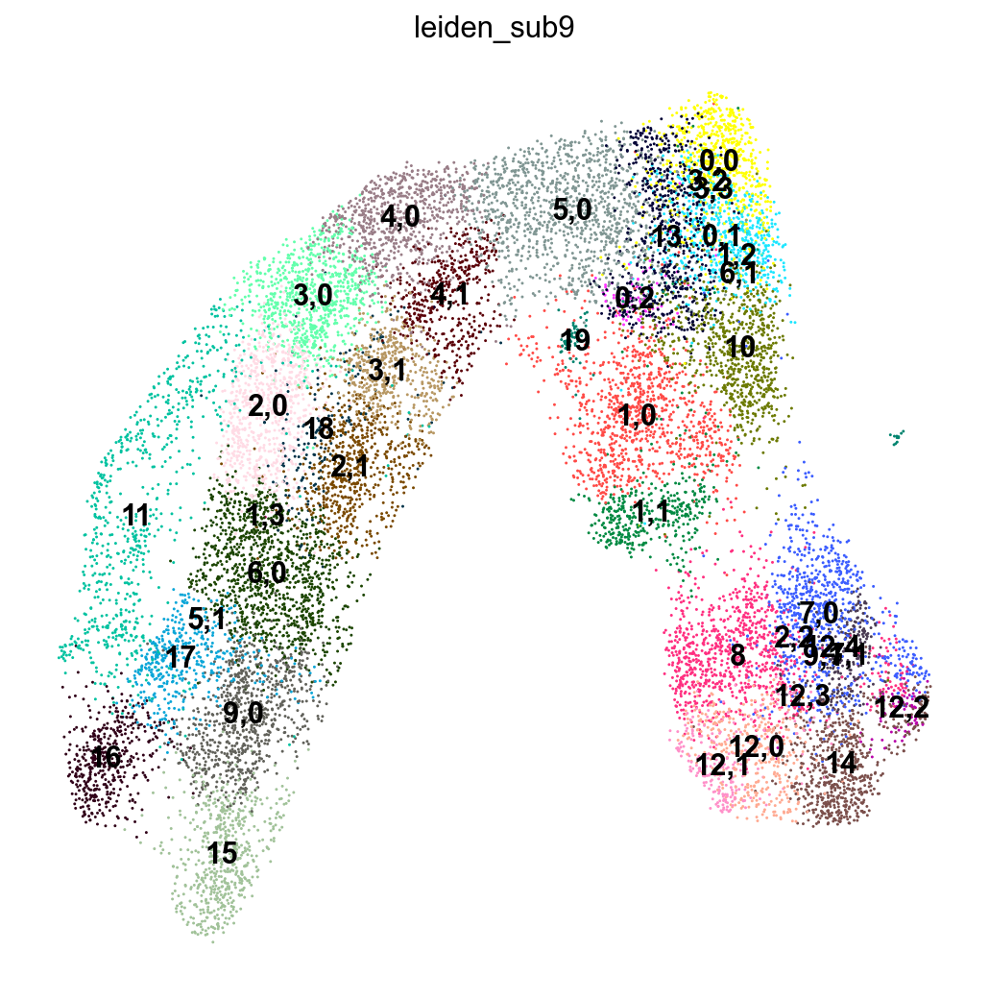

5,0     1176
6,0     1134
1,0      988
8        911
9,0      833
3,0      816
4,0      777
7,0      769
10       757
2,0      757
11       704
0,0      702
13       661
14       645
0,1      635
2,1      632
15       588
3,1      469
16       460
4,1      447
17       433
1,1      409
12,0     383
7,1      249
12,1     227
18       184
0,2       86
12,2      68
19        68
9,1        1
12,3       1
12,4       1
5,1        1
3,3        1
3,2        1
2,2        1
1,3        1
1,2        1
6,1        1
Name: leiden_sub9, dtype: int64

In [14]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_sub9']`
categories: 0,0, 0,1, 0,2, etc.
var_group_labels: Prlf. Ductal, Ductal


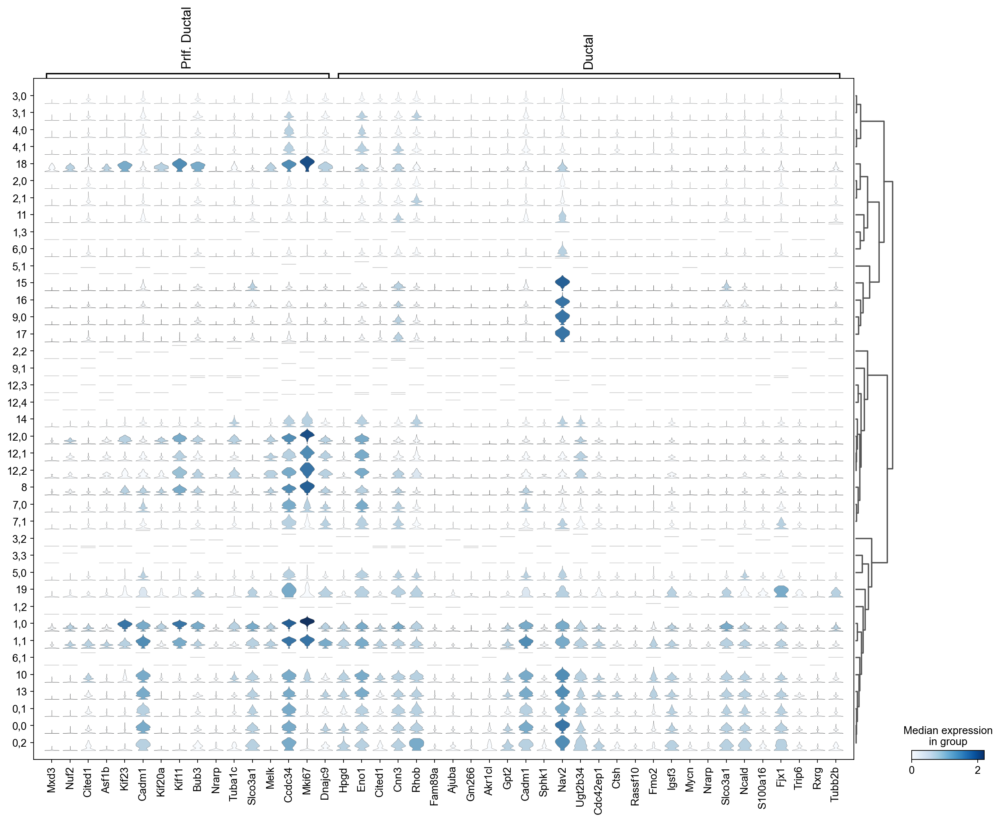

In [15]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Prlf. Ductal', 'Ductal']
}, groupby=new_key, dendrogram=True)

- 12,0: Mat. Acinar
- 12,1: Mat. Acinar
- 12,2: Mat. Acinar



Subcluster 13

In [16]:
c_id = 13

In [17]:
init_clus_dict[str(c_id)]

['Ductal']

In [18]:
orig_key = 'leiden_sub9'
new_key = 'leiden_sub10' 
new_rg_key = 'rg_sub10'
sub_key = str(c_id)

running Leiden clustering
    finished: found 39 clusters and added
    'leiden_sub10', the cluster labels (adata.obs, categorical) (0:00:00)


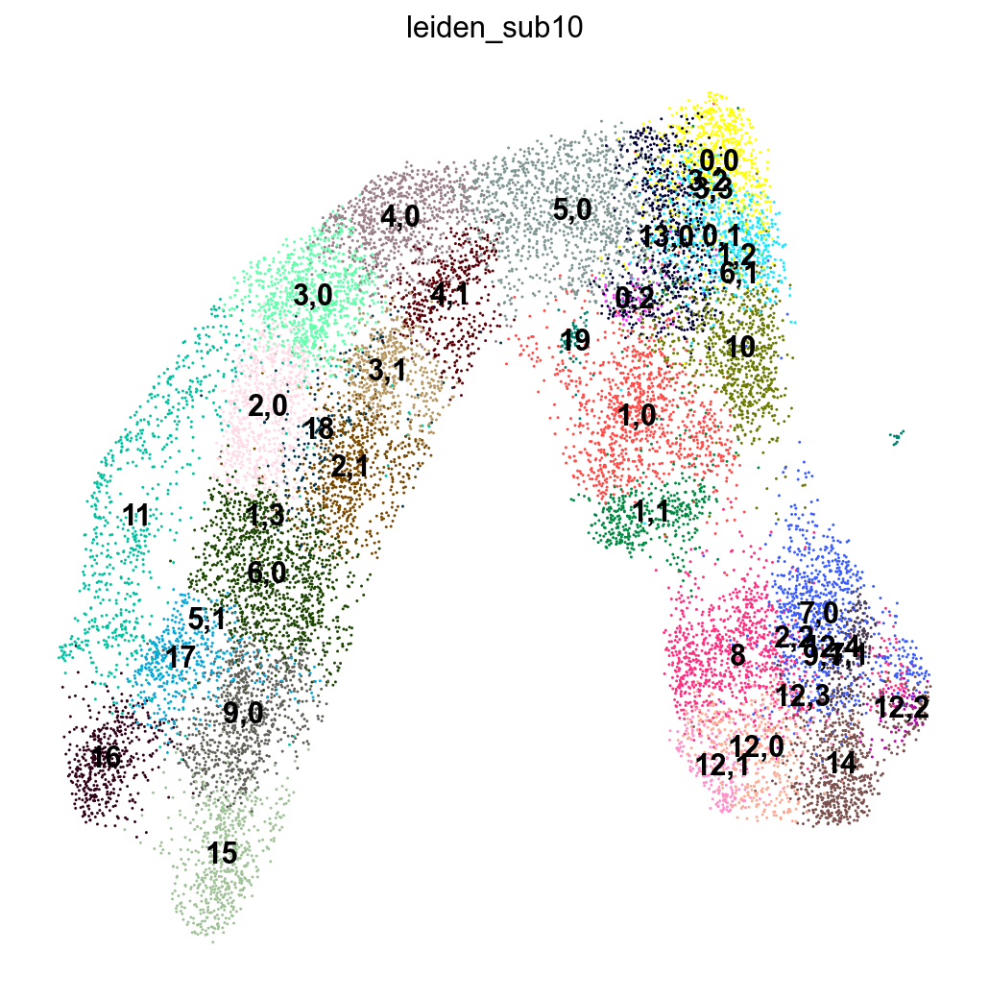

5,0     1176
6,0     1134
1,0      988
8        911
9,0      833
3,0      816
4,0      777
7,0      769
10       757
2,0      757
11       704
0,0      702
13,0     661
14       645
0,1      635
2,1      632
15       588
3,1      469
16       460
4,1      447
17       433
1,1      409
12,0     383
7,1      249
12,1     227
18       184
0,2       86
12,2      68
19        68
9,1        1
12,3       1
12,4       1
5,1        1
3,3        1
3,2        1
2,2        1
1,3        1
1,2        1
6,1        1
Name: leiden_sub10, dtype: int64

In [19]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

- 13,0 Ductal



Subcluster 15

In [20]:
c_id = 15

In [21]:
init_clus_dict[str(c_id)]

['Beta']

In [22]:
orig_key = 'leiden_sub10'
new_key = 'leiden_sub11' 
new_rg_key = 'rg_sub11'
sub_key = str(c_id)

running Leiden clustering
    finished: found 39 clusters and added
    'leiden_sub11', the cluster labels (adata.obs, categorical) (0:00:00)


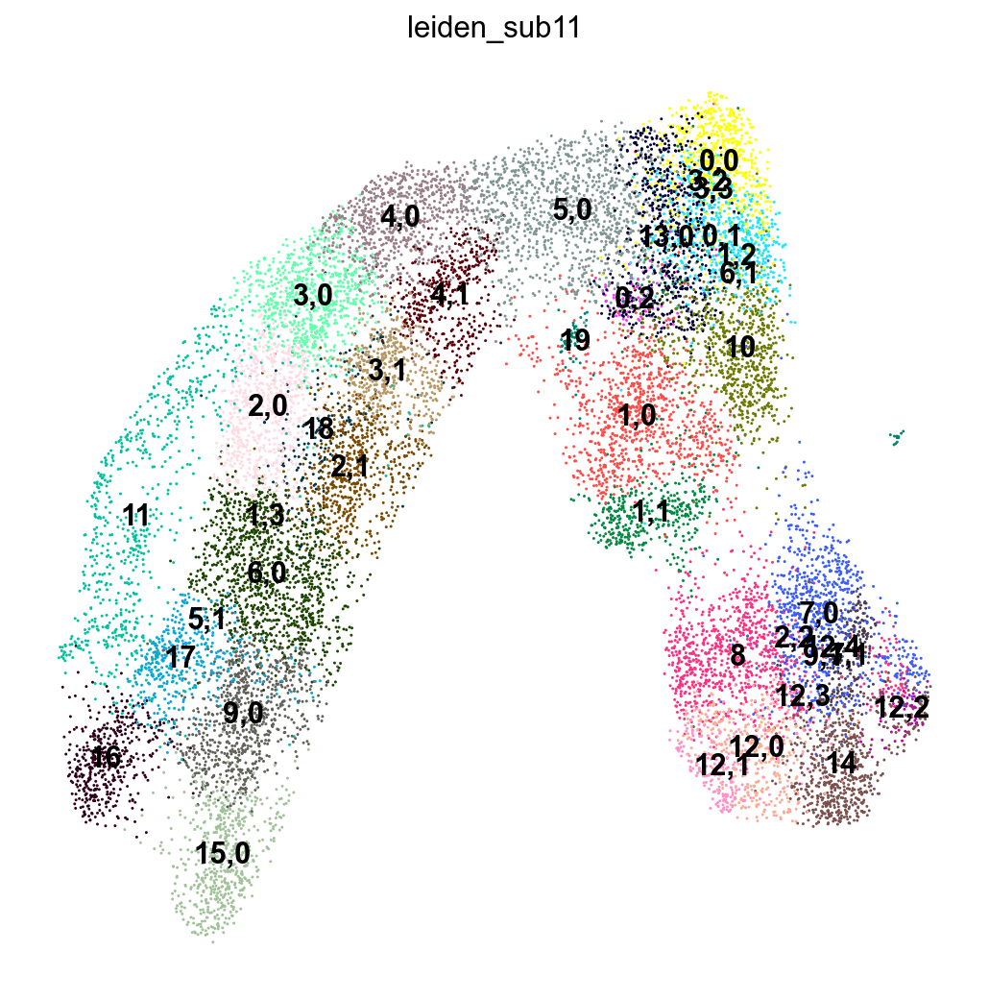

5,0     1176
6,0     1134
1,0      988
8        911
9,0      833
3,0      816
4,0      777
7,0      769
10       757
2,0      757
11       704
0,0      702
13,0     661
14       645
0,1      635
2,1      632
15,0     588
3,1      469
16       460
4,1      447
17       433
1,1      409
12,0     383
7,1      249
12,1     227
18       184
0,2       86
12,2      68
19        68
9,1        1
12,3       1
12,4       1
5,1        1
3,3        1
3,2        1
2,2        1
1,3        1
1,2        1
6,1        1
Name: leiden_sub11, dtype: int64

In [23]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

- 15,0: Beta



Subcluster 18

In [24]:
c_id = 18

In [25]:
init_clus_dict[str(c_id)]

['Ngn3 High cycling']

In [26]:
orig_key = 'leiden_sub11'
new_key = 'leiden_sub12' 
new_rg_key = 'rg_sub12'
sub_key = str(c_id)

running Leiden clustering
    finished: found 44 clusters and added
    'leiden_sub12', the cluster labels (adata.obs, categorical) (0:00:00)


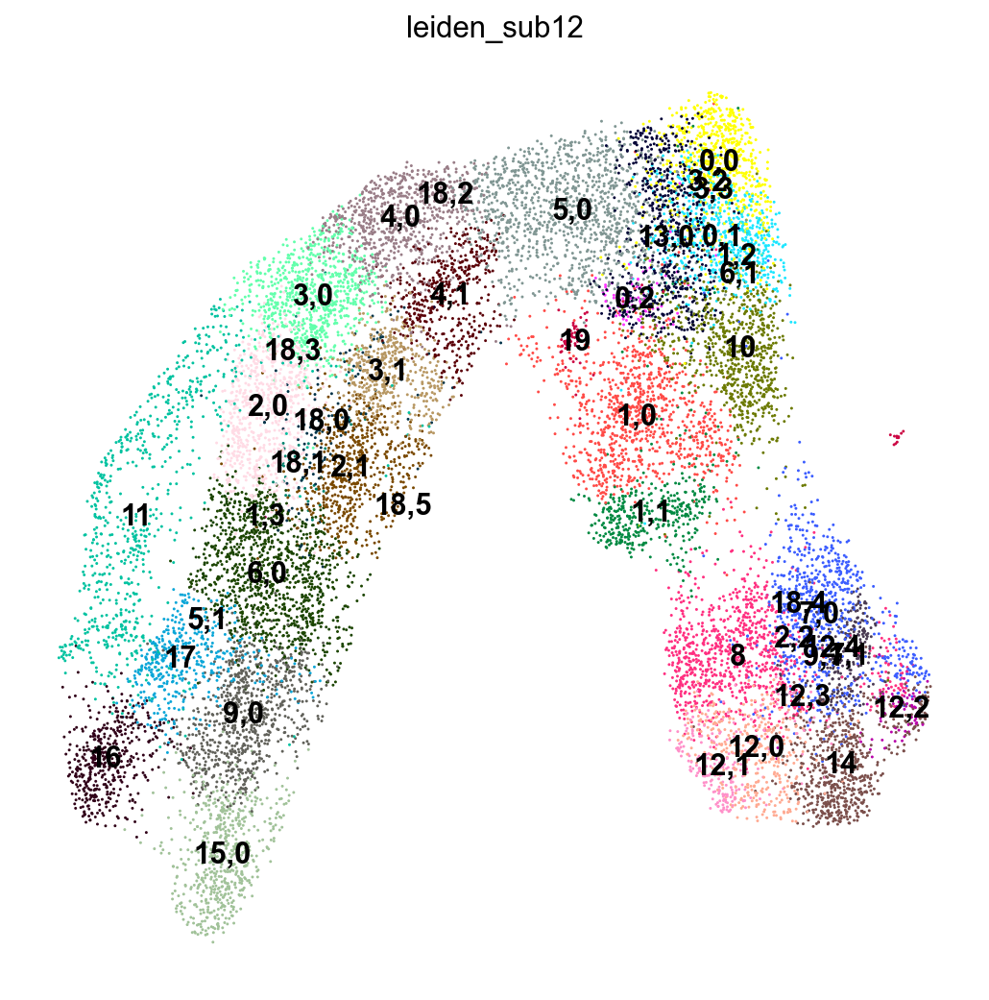

5,0     1176
6,0     1134
1,0      988
8        911
9,0      833
3,0      816
4,0      777
7,0      769
10       757
2,0      757
11       704
0,0      702
13,0     661
14       645
0,1      635
2,1      632
15,0     588
3,1      469
16       460
4,1      447
17       433
1,1      409
12,0     383
7,1      249
12,1     227
18,0     139
0,2       86
12,2      68
19        68
18,1      41
3,3        1
12,3       1
12,4       1
9,1        1
1,2        1
1,3        1
6,1        1
5,1        1
2,2        1
18,2       1
18,3       1
18,4       1
18,5       1
3,2        1
Name: leiden_sub12, dtype: int64

In [27]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_sub12']`
categories: 0,0, 0,1, 0,2, etc.
var_group_labels: Ngn3 High early, Ngn3 High late


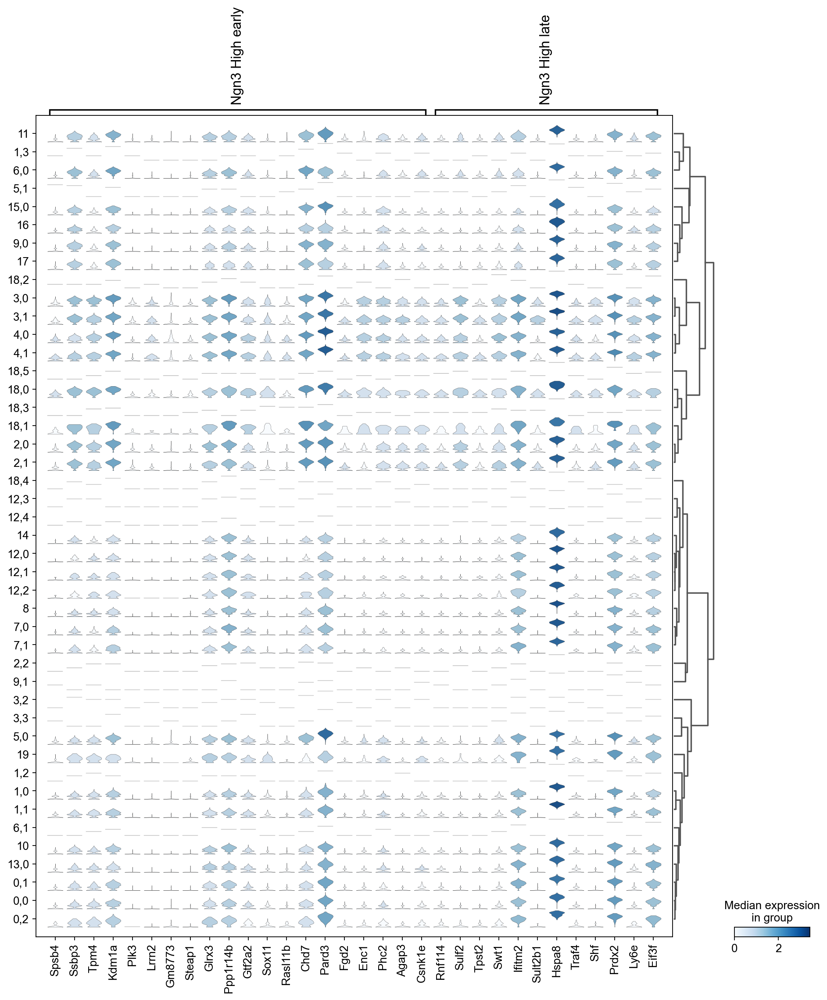

In [28]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Ngn3 High early', 'Ngn3 High late']
}, groupby=new_key, dendrogram=True)

In [29]:
adata[adata.obs["leiden"]=="18"].obs["proliferation"].value_counts()

Cycling        169
Non-Cycling     15
Name: proliferation, dtype: int64

In [30]:
adata[adata.obs[new_key]=="18,0"].obs["proliferation"].value_counts()

Cycling    139
Name: proliferation, dtype: int64

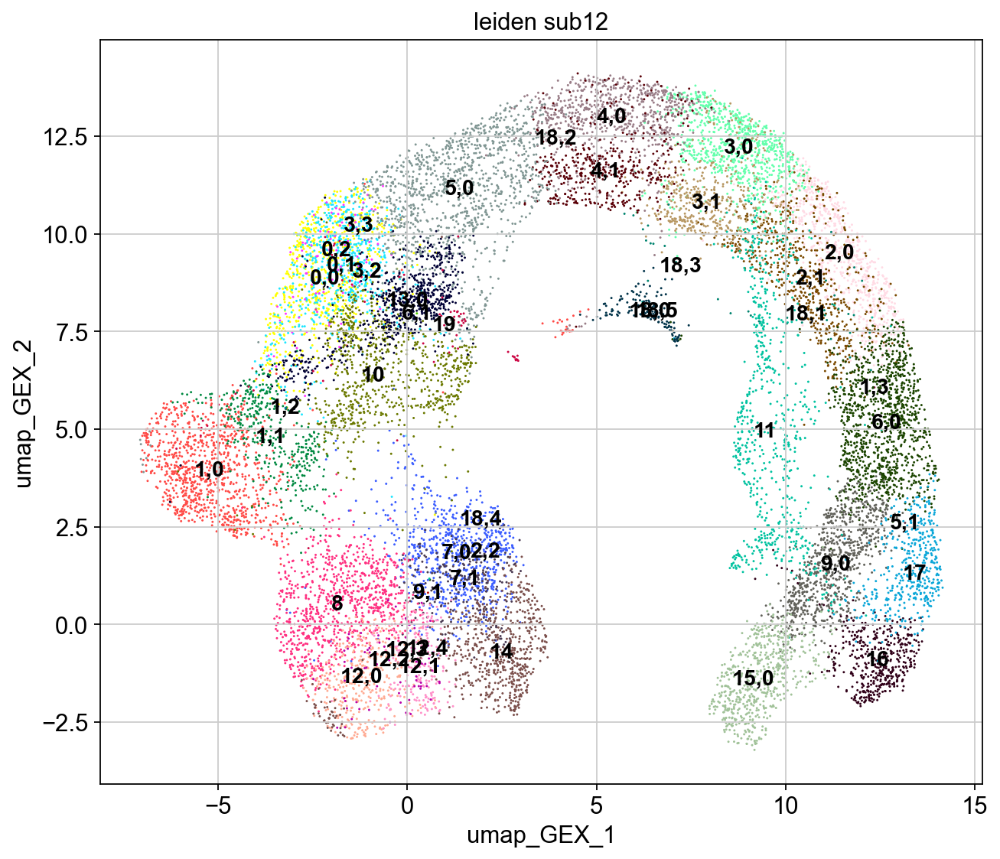

In [31]:
sc.pl.scatter(adata, x="umap_GEX_1", y="umap_GEX_2", color=new_key, legend_loc="on data")

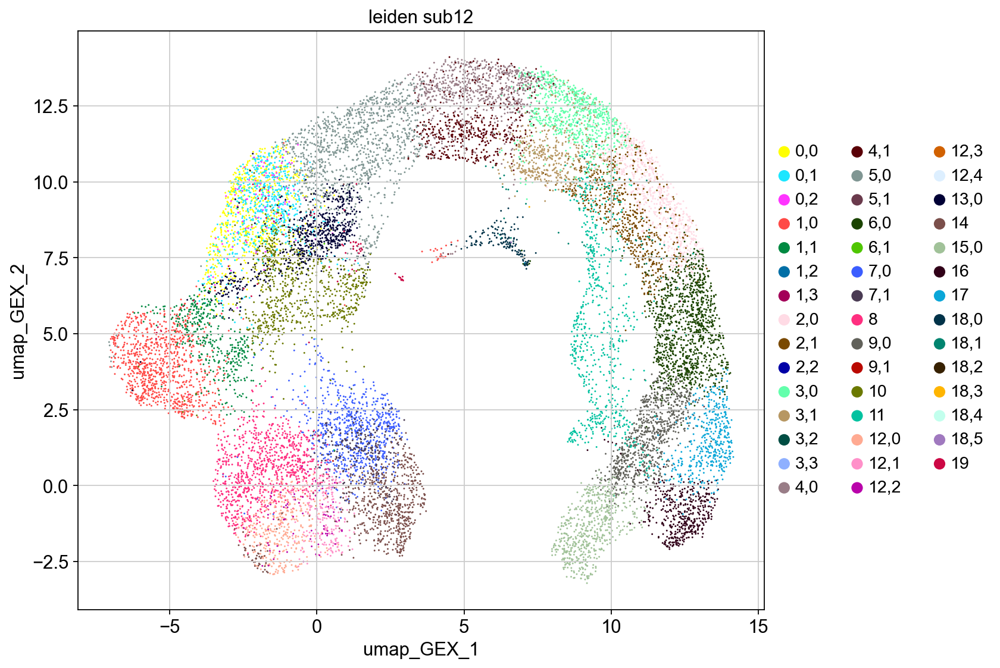

In [32]:
sc.pl.scatter(adata, x="umap_GEX_1", y="umap_GEX_2", color=new_key)

In [33]:
adata.obs["tmp"] = adata.obs.apply(lambda x: x[new_key] if x[new_key] in ("18,0", "18,1") else "0", axis=1)

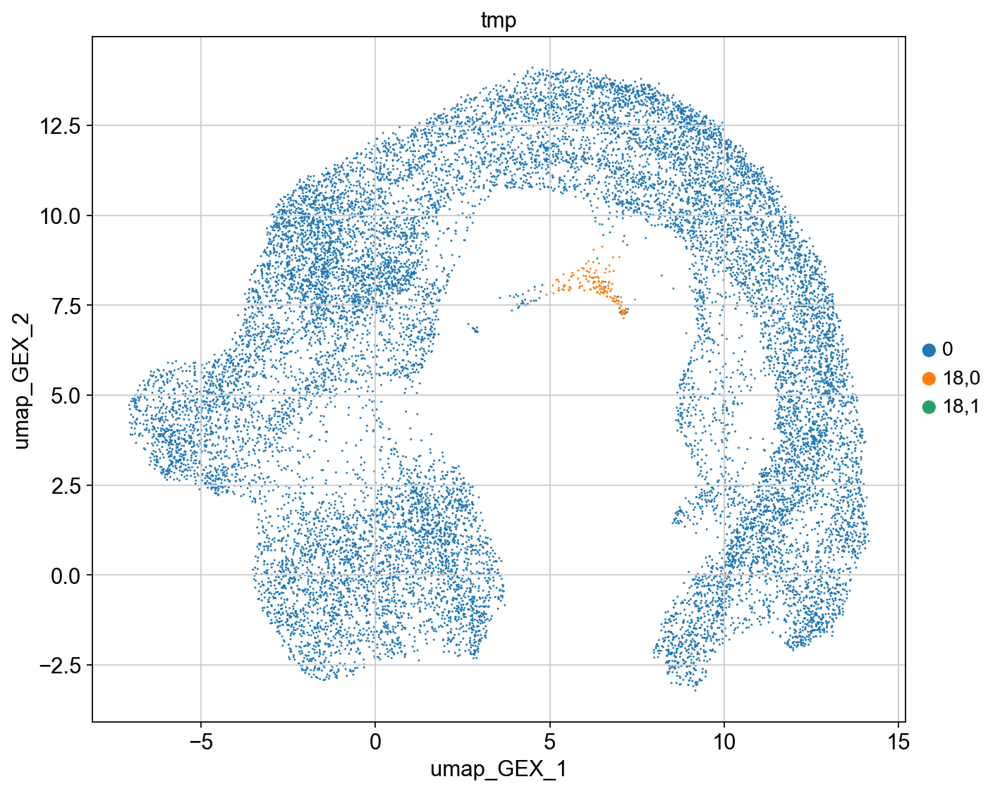

In [34]:
sc.pl.scatter(adata, x="umap_GEX_1", y="umap_GEX_2", color="tmp")

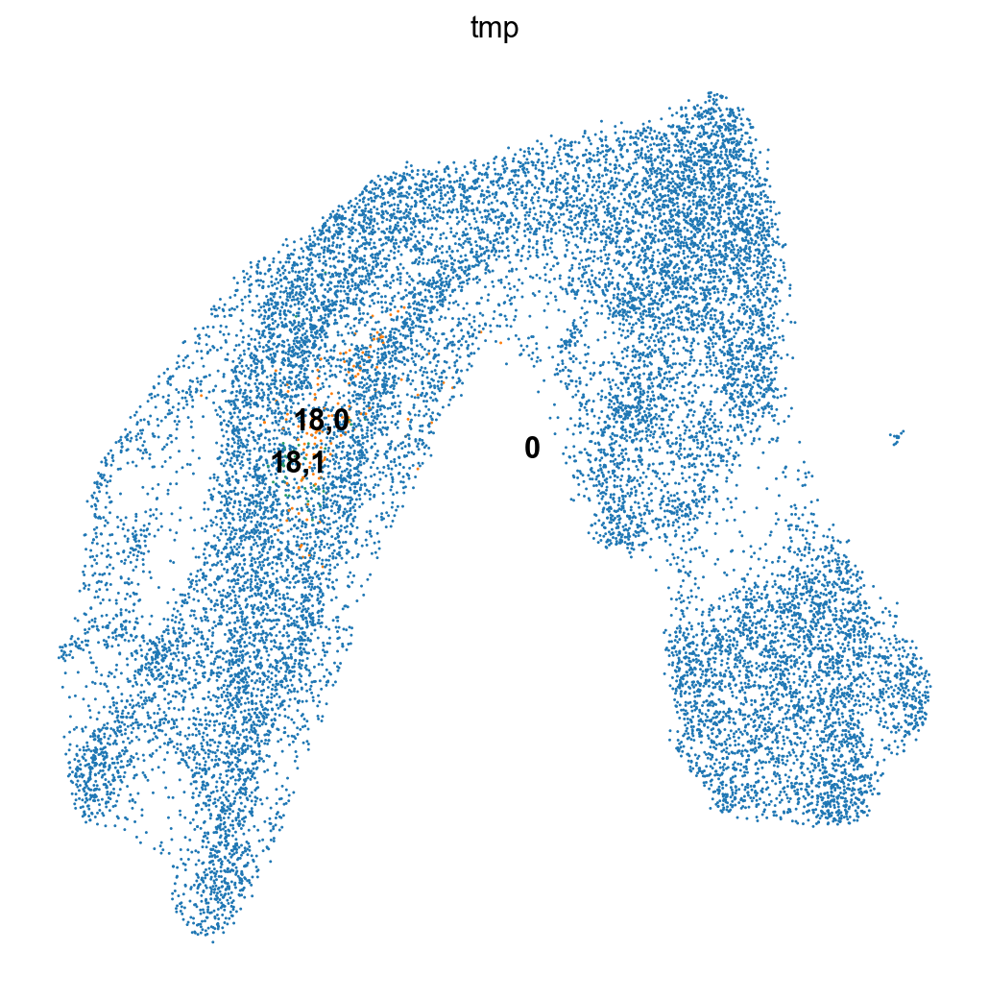

In [35]:
sc.pl.umap(adata, color="tmp", legend_loc='on data')

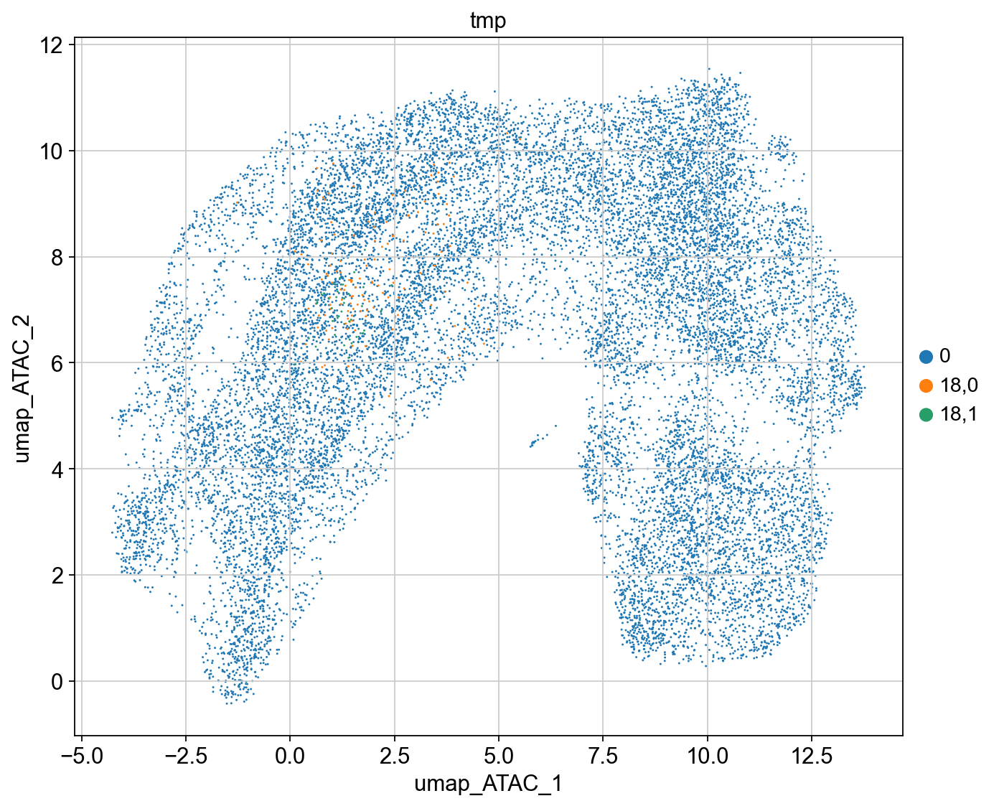

In [36]:
sc.pl.scatter(adata, x="umap_ATAC_1", y="umap_ATAC_2", color="tmp")

- 18,0: Ngn3 high cycling
- 18,1: low q
- 18,2: low q
- 18,3: low q
- 18,4: low q
- 18,5: low q



Subcluster 11

In [37]:
c_id = 11

In [38]:
init_clus_dict[str(c_id)]

['Fev+ Delta', 'Fev+ Epsilon', 'Epsilon', 'Delta']

In [39]:
orig_key = 'leiden_sub12'
new_key = 'leiden_sub13' 
new_rg_key = 'rg_sub13'
sub_key = str(c_id)

running Leiden clustering
    finished: found 48 clusters and added
    'leiden_sub13', the cluster labels (adata.obs, categorical) (0:00:00)


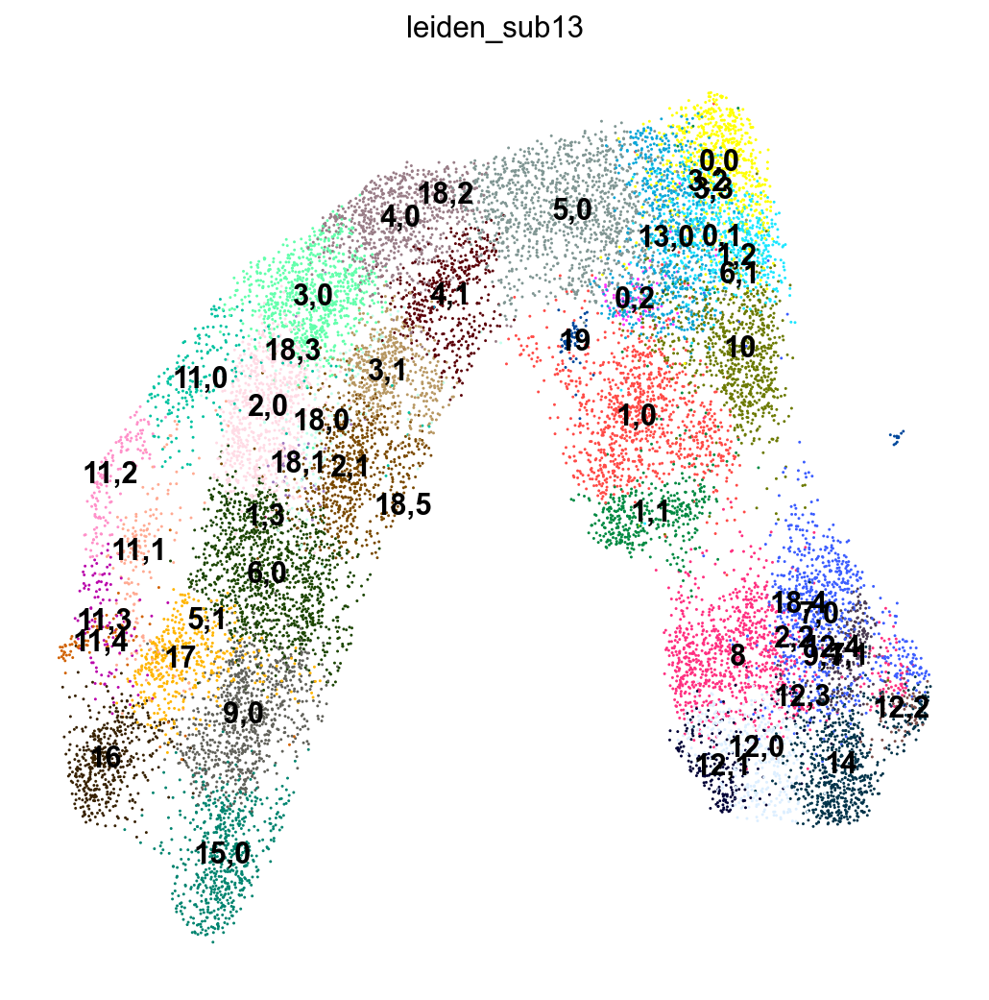

5,0     1176
6,0     1134
1,0      988
8        911
9,0      833
3,0      816
4,0      777
7,0      769
10       757
2,0      757
0,0      702
13,0     661
14       645
0,1      635
2,1      632
15,0     588
3,1      469
16       460
4,1      447
17       433
1,1      409
12,0     383
7,1      249
12,1     227
11,0     204
11,1     176
18,0     139
11,2     137
11,3     110
0,2       86
11,4      77
12,2      68
19        68
18,1      41
6,1        1
12,3       1
12,4       1
5,1        1
3,3        1
3,2        1
2,2        1
1,3        1
1,2        1
18,2       1
18,3       1
18,4       1
18,5       1
9,1        1
Name: leiden_sub13, dtype: int64

In [40]:
res=0.5
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

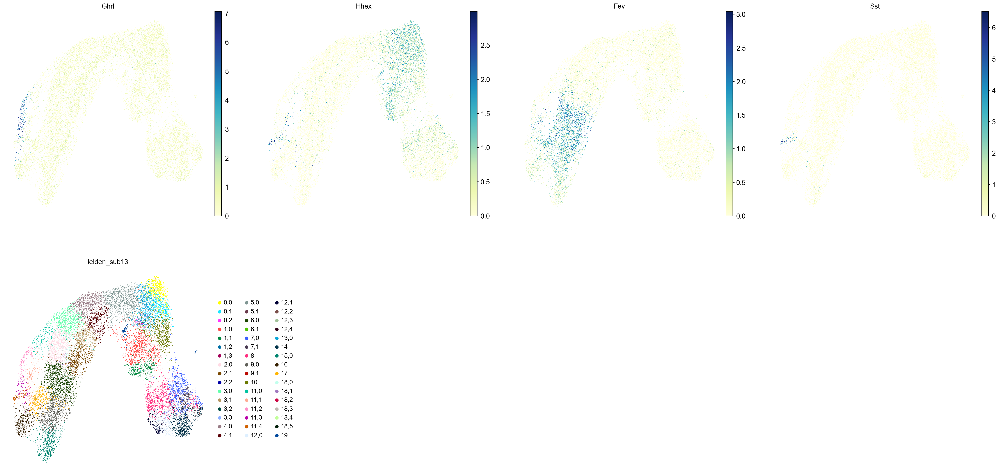

In [41]:
sc.pl.umap(adata, color=["Ghrl", "Hhex", "Fev", "Sst", new_key])

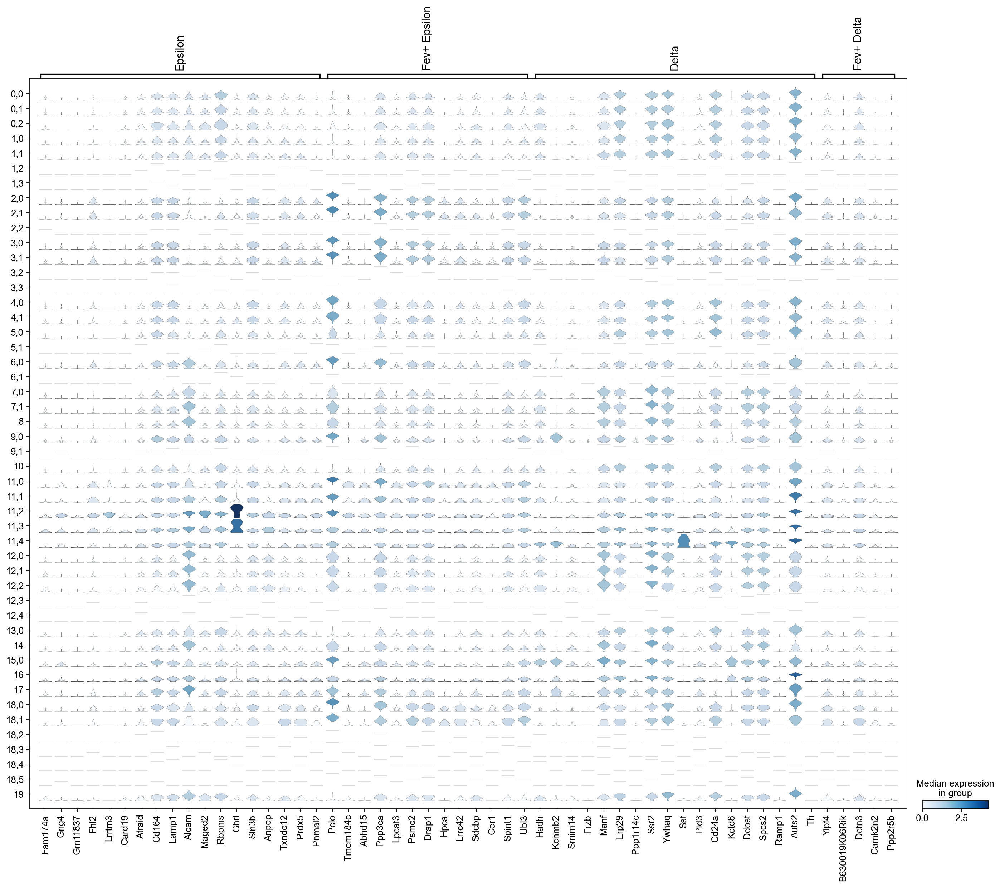

In [42]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Epsilon', 'Fev+ Epsilon', 'Delta', 'Fev+ Delta']
}, groupby=new_key)

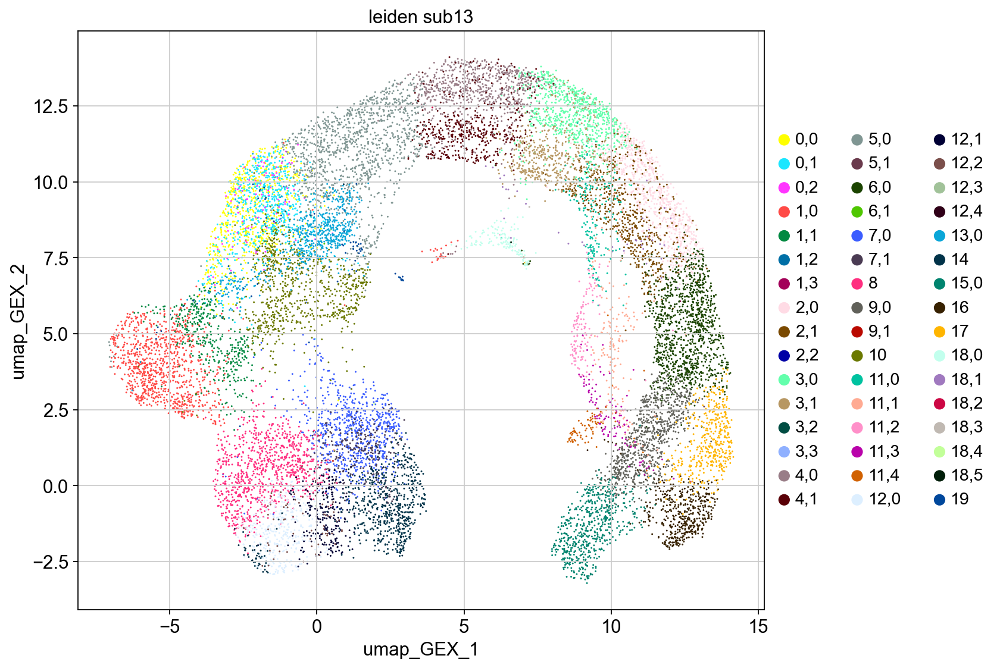

In [43]:
sc.pl.scatter(adata, x="umap_GEX_1", y="umap_GEX_2", color=new_key)

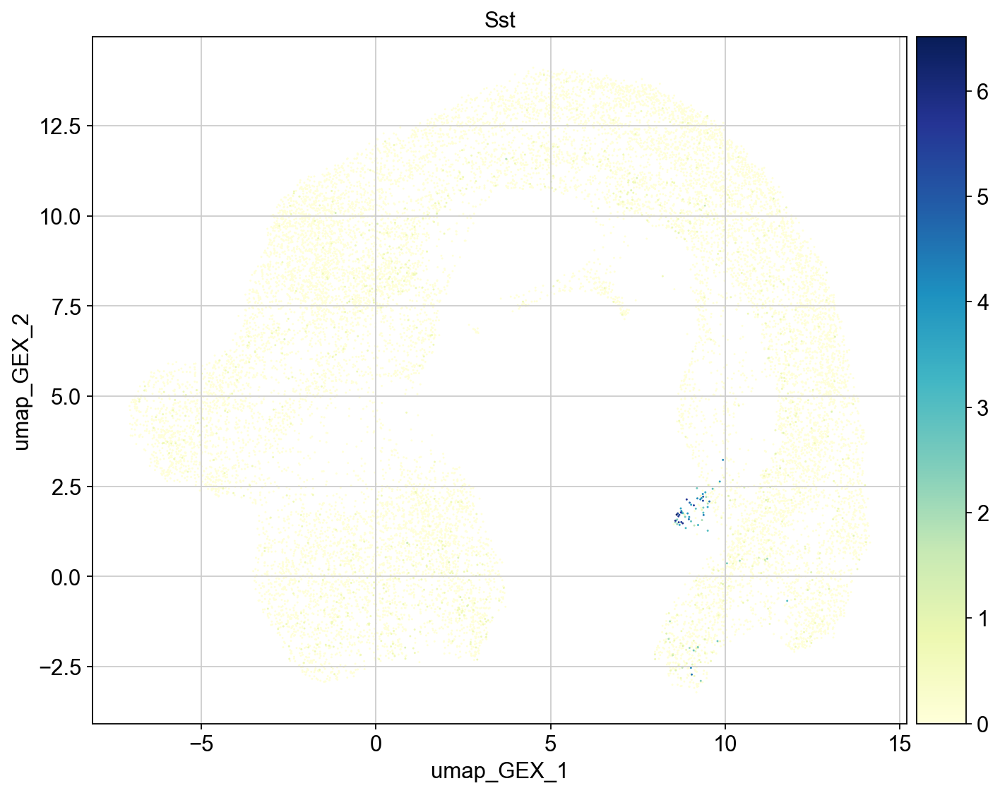

In [44]:
sc.pl.scatter(adata, x="umap_GEX_1", y="umap_GEX_2", color="Sst")

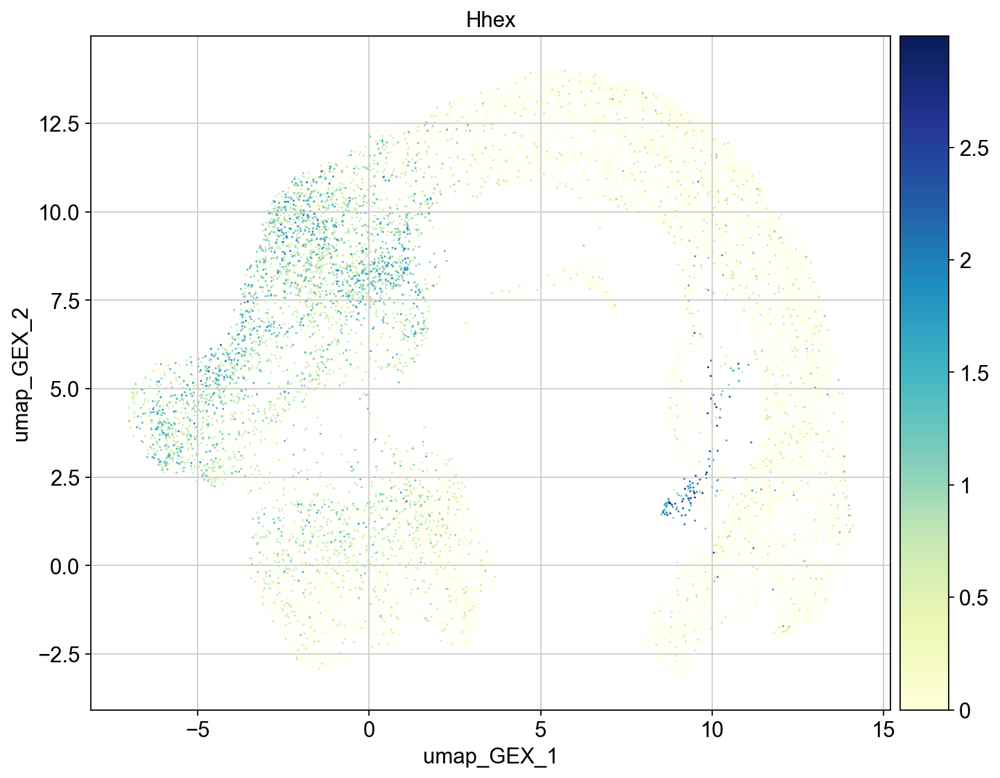

In [45]:
sc.pl.scatter(adata, x="umap_GEX_1", y="umap_GEX_2", color="Hhex")

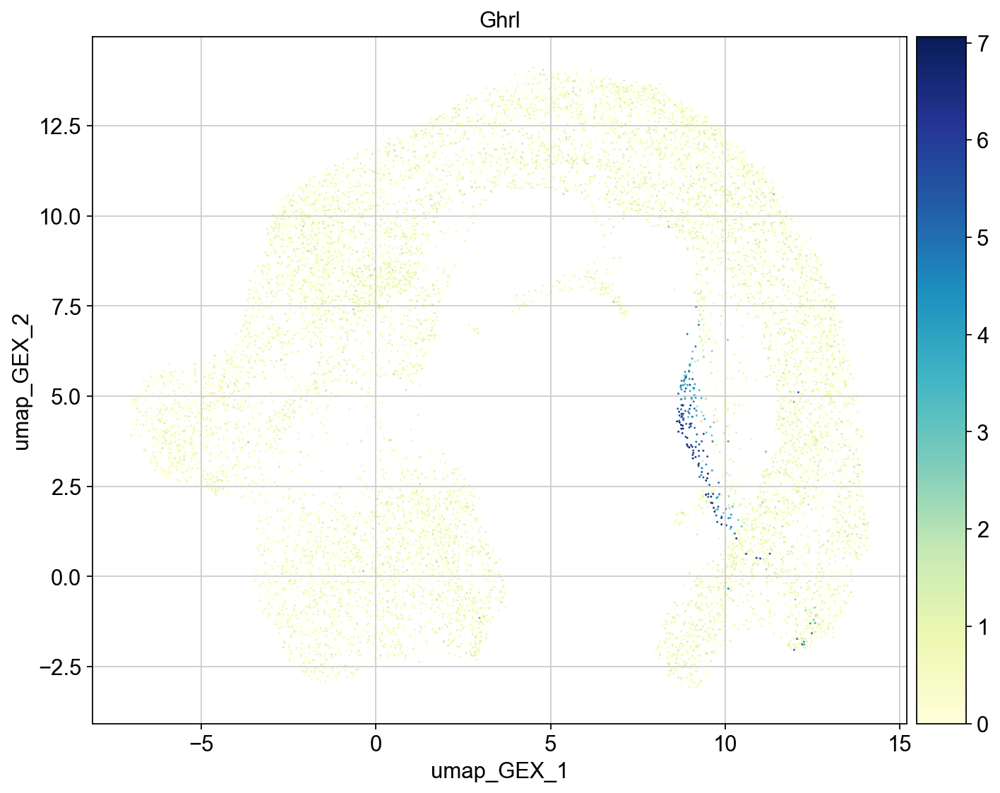

In [46]:
sc.pl.scatter(adata, x="umap_GEX_1", y="umap_GEX_2", color="Ghrl")

- 11,0: Eps/Delta progenitor
- 11,1: Fev+ Delta
- 11,2: Epsilon
- 11,3: Epsilon
- 11,4: Delta

Cluster 8

In [47]:
c_id = 8

In [48]:
init_clus_dict[str(c_id)]

['Imm. Acinar']

In [49]:
orig_key = 'leiden_sub13'
new_key = 'leiden_sub14' 
new_rg_key = 'rg_sub14'
sub_key = str(c_id)

running Leiden clustering
    finished: found 50 clusters and added
    'leiden_sub14', the cluster labels (adata.obs, categorical) (0:00:00)


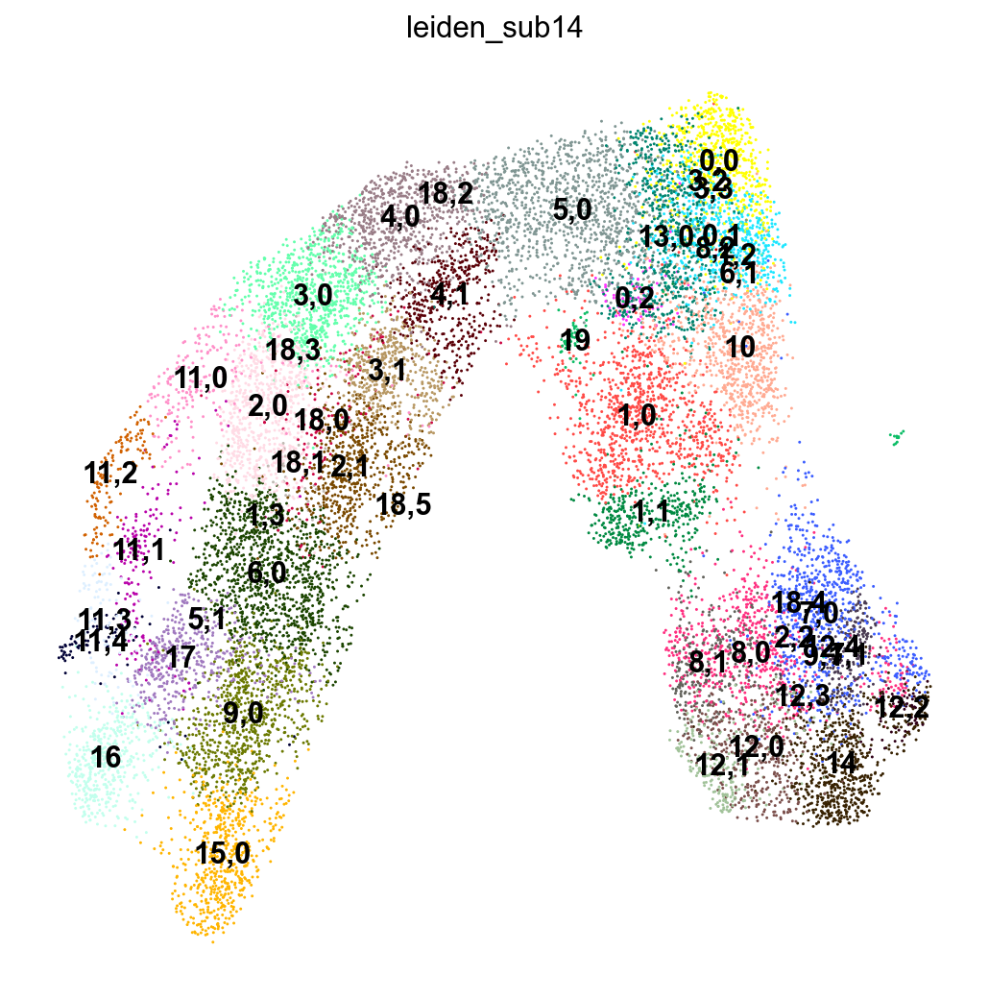

5,0     1176
6,0     1134
1,0      988
9,0      833
3,0      816
4,0      777
7,0      769
10       757
2,0      757
0,0      702
13,0     661
14       645
0,1      635
2,1      632
8,0      624
15,0     588
3,1      469
16       460
4,1      447
17       433
1,1      409
12,0     383
8,1      286
7,1      249
12,1     227
11,0     204
11,1     176
18,0     139
11,2     137
11,3     110
0,2       86
11,4      77
12,2      68
19        68
18,1      41
9,1        1
8,2        1
12,3       1
12,4       1
6,1        1
1,2        1
5,1        1
1,3        1
3,3        1
3,2        1
18,2       1
18,3       1
18,4       1
18,5       1
2,2        1
Name: leiden_sub14, dtype: int64

In [50]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_sub14']`
categories: 0,0, 0,1, 0,2, etc.
var_group_labels: Fev+ Beta, Beta


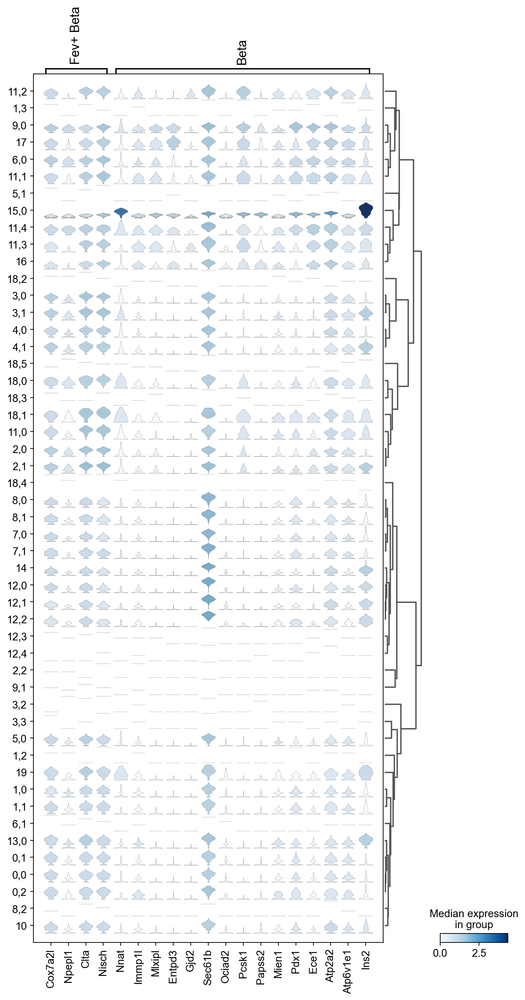

In [51]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Fev+ Beta', 'Beta']
}, groupby=new_key, dendrogram=True)

- 8,0: Imm. Acinar
- 8,1: Imm. Acinar
- 8,2: low q


Subcluster 14

In [52]:
c_id = 14

In [53]:
init_clus_dict[str(c_id)]

['Mat. Acinar']

In [54]:
orig_key = 'leiden_sub14'
new_key = 'leiden_sub15' 
new_rg_key = 'rg_sub15'
sub_key = str(c_id)

running Leiden clustering
    finished: found 52 clusters and added
    'leiden_sub15', the cluster labels (adata.obs, categorical) (0:00:00)


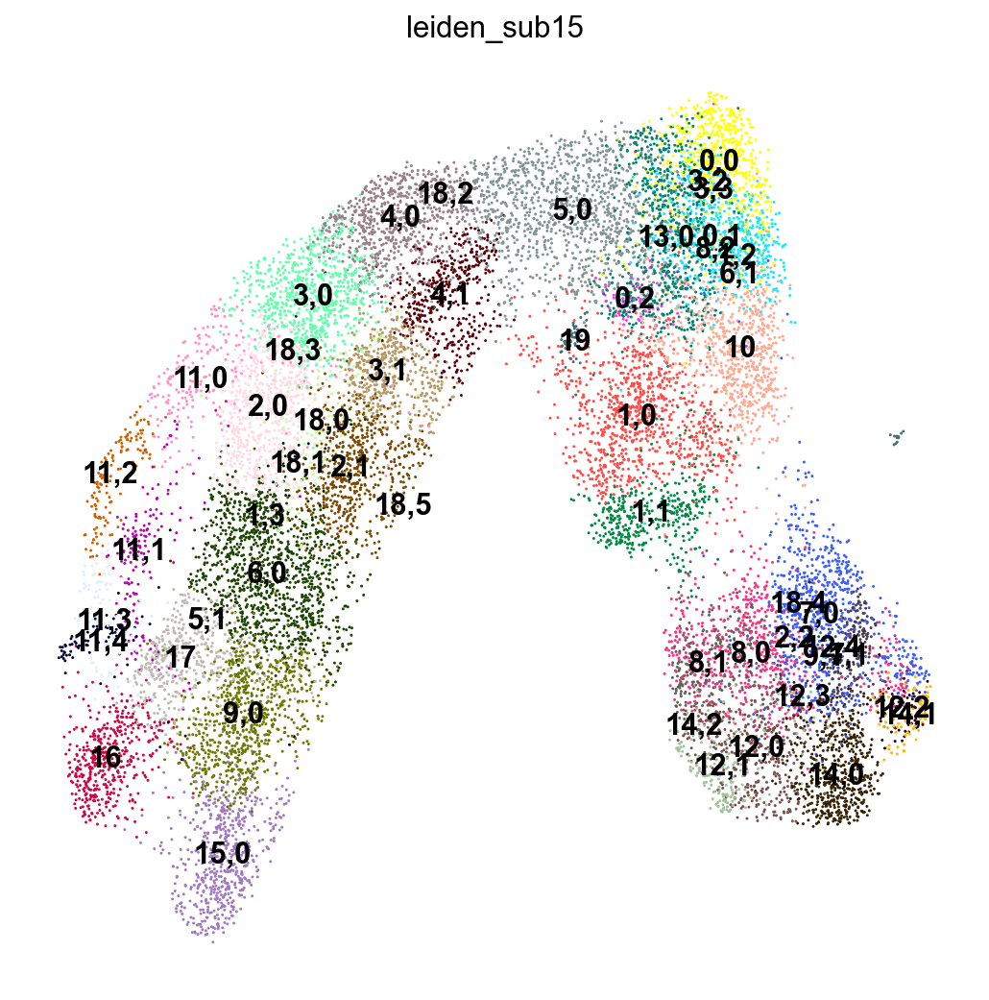

5,0     1176
6,0     1134
1,0      988
9,0      833
3,0      816
4,0      777
7,0      769
10       757
2,0      757
0,0      702
13,0     661
0,1      635
2,1      632
8,0      624
15,0     588
14,0     554
3,1      469
16       460
4,1      447
17       433
1,1      409
12,0     383
8,1      286
7,1      249
12,1     227
11,0     204
11,1     176
18,0     139
11,2     137
11,3     110
14,1      90
0,2       86
11,4      77
12,2      68
19        68
18,1      41
8,2        1
1,3        1
18,5       1
18,4       1
18,3       1
18,2       1
1,2        1
2,2        1
12,3       1
3,2        1
14,2       1
3,3        1
5,1        1
6,1        1
12,4       1
9,1        1
Name: leiden_sub15, dtype: int64

In [55]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_sub15']`
categories: 0,0, 0,1, 0,2, etc.
var_group_labels: Prlf. Acinar, Mat. Acinar


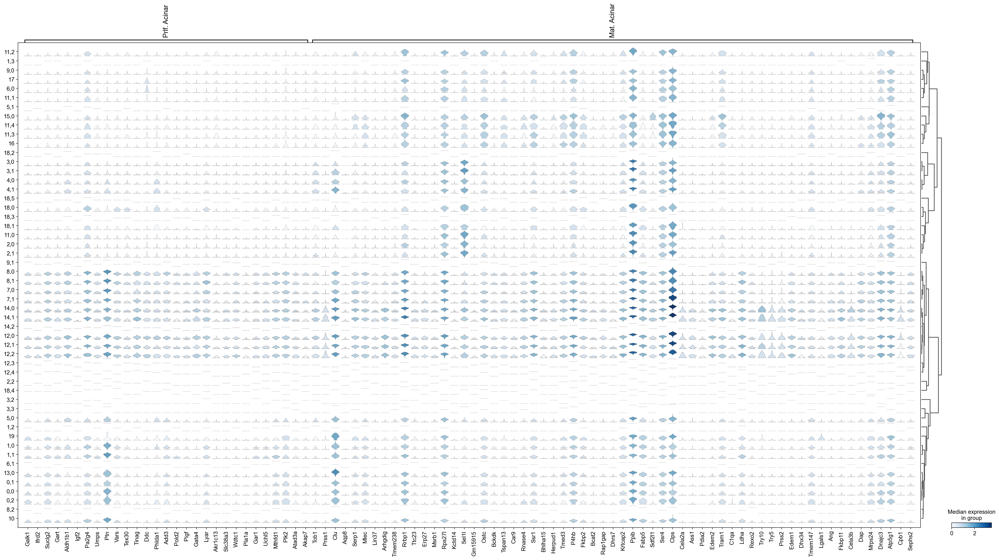

In [56]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Prlf. Acinar', 'Mat. Acinar']
}, groupby=new_key, dendrogram=True)

- 14,0: Mature Acinar
- 14,1: Mature Acinar
- 14,2: low q

Cluster 10

In [57]:
c_id = 10

In [58]:
init_clus_dict[str(c_id)]

['Ductal']

In [59]:
orig_key = 'leiden_sub15'
new_key = 'leiden_sub16' 
new_rg_key = 'rg_sub16'
sub_key = str(c_id)

running Leiden clustering
    finished: found 55 clusters and added
    'leiden_sub16', the cluster labels (adata.obs, categorical) (0:00:00)


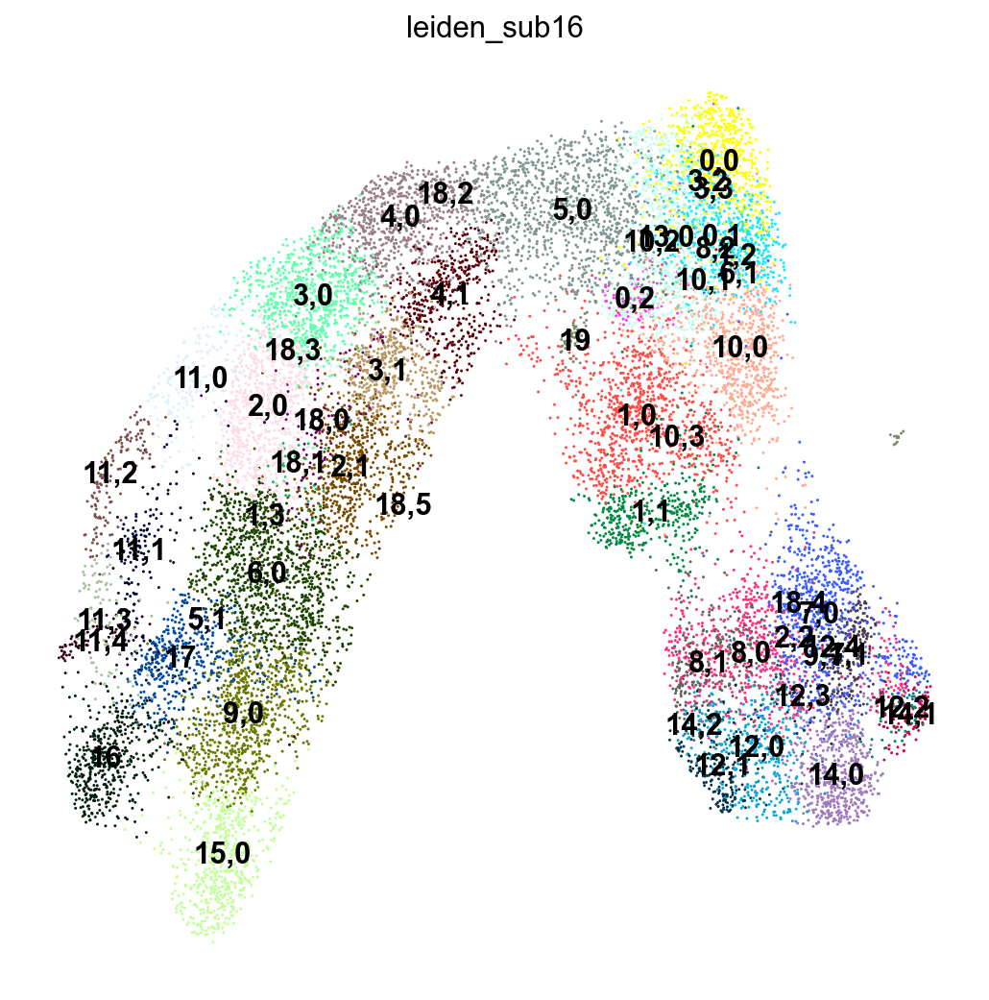

5,0     1176
6,0     1134
1,0      988
9,0      833
3,0      816
4,0      777
7,0      769
2,0      757
10,0     754
0,0      702
13,0     661
0,1      635
2,1      632
8,0      624
15,0     588
14,0     554
3,1      469
16       460
4,1      447
17       433
1,1      409
12,0     383
8,1      286
7,1      249
12,1     227
11,0     204
11,1     176
18,0     139
11,2     137
11,3     110
14,1      90
0,2       86
11,4      77
12,2      68
19        68
18,1      41
10,3       1
10,2       1
18,5       1
18,4       1
18,3       1
18,2       1
3,2        1
3,3        1
1,3        1
5,1        1
14,2       1
1,2        1
6,1        1
8,2        1
12,4       1
12,3       1
9,1        1
10,1       1
2,2        1
Name: leiden_sub16, dtype: int64

In [60]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

- 10,0: Ductal
- 10,1: low q


Cluster 19

In [61]:
c_id = 19

In [62]:
init_clus_dict[str(c_id)]

['Ductal']

In [63]:
orig_key = 'leiden_sub16'
new_key = 'leiden_sub17' 
new_rg_key = 'rg_sub17'
sub_key = str(c_id)

running Leiden clustering
    finished: found 56 clusters and added
    'leiden_sub17', the cluster labels (adata.obs, categorical) (0:00:00)


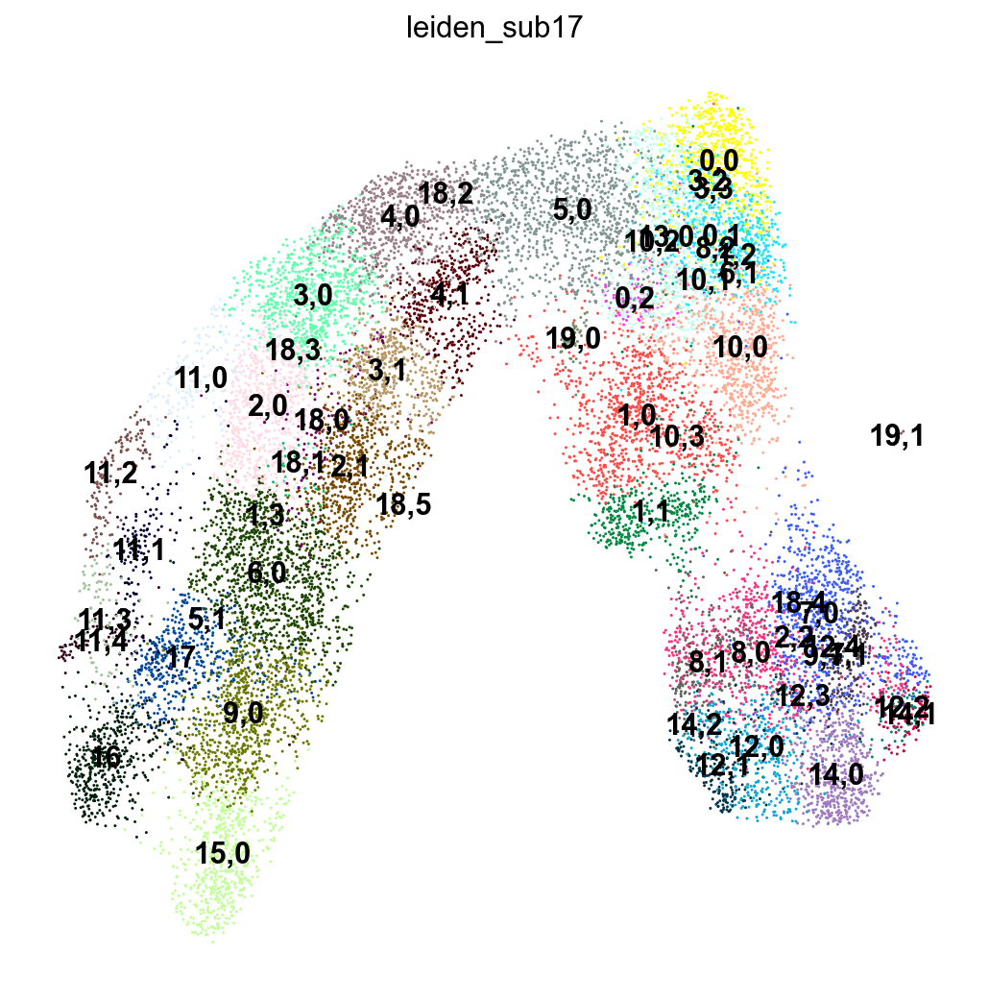

5,0     1176
6,0     1134
1,0      988
9,0      833
3,0      816
4,0      777
7,0      769
2,0      757
10,0     754
0,0      702
13,0     661
0,1      635
2,1      632
8,0      624
15,0     588
14,0     554
3,1      469
16       460
4,1      447
17       433
1,1      409
12,0     383
8,1      286
7,1      249
12,1     227
11,0     204
11,1     176
18,0     139
11,2     137
11,3     110
14,1      90
0,2       86
11,4      77
12,2      68
19,0      56
18,1      41
19,1      12
10,3       1
3,2        1
1,2        1
18,5       1
18,4       1
18,3       1
18,2       1
1,3        1
2,2        1
3,3        1
10,2       1
5,1        1
14,2       1
6,1        1
8,2        1
9,1        1
12,4       1
12,3       1
10,1       1
Name: leiden_sub17, dtype: int64

In [64]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_sub17']`
categories: 0,0, 0,1, 0,2, etc.
var_group_labels: Ductal, Prlf. Ductal


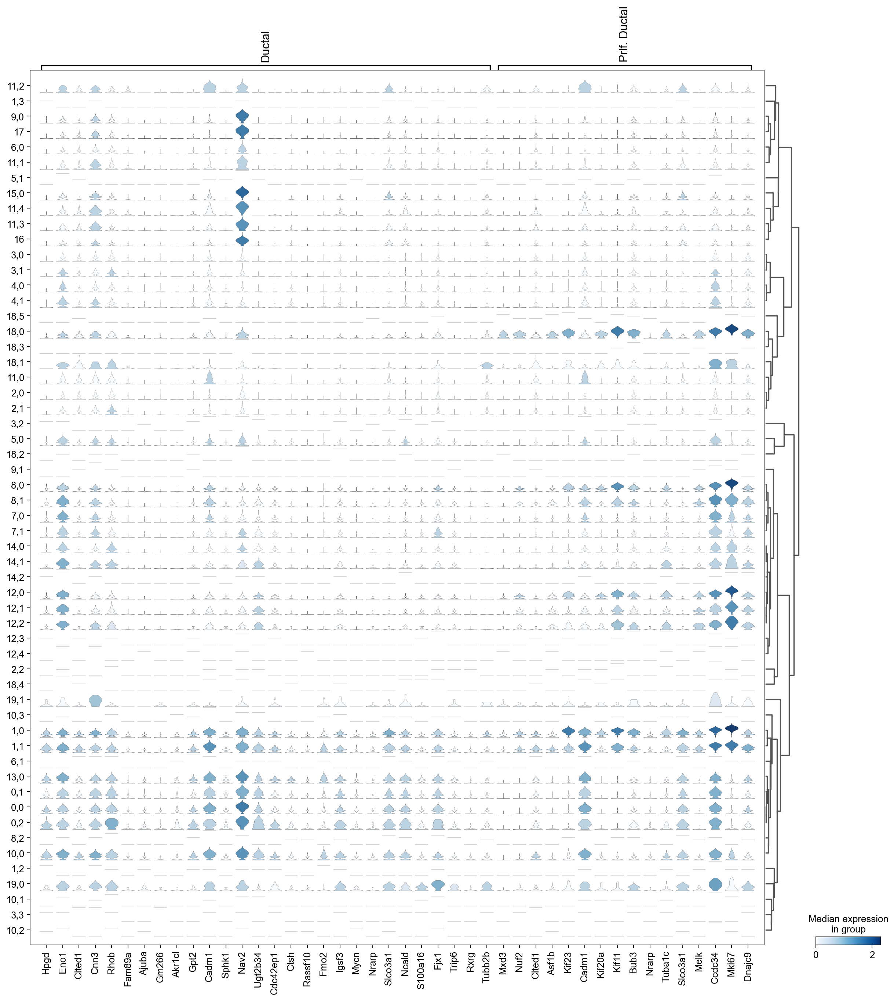

In [65]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Ductal', 'Prlf. Ductal']
}, groupby=new_key, dendrogram=True)

In [66]:
adata[adata.obs[new_key]=="19,0"].obs["doublet_calls"].value_counts()

0    33
1    16
2     5
3     2
Name: doublet_calls, dtype: int64

In [67]:
adata[adata.obs[new_key]=="19,1"].obs["doublet_calls"].value_counts()

0    6
1    5
2    1
Name: doublet_calls, dtype: int64

In [68]:
adata[adata.obs[new_key]=="19,0"].obs["proliferation"].value_counts()

Non-Cycling    29
Cycling        27
Name: proliferation, dtype: int64

In [69]:
adata[adata.obs[new_key]=="19,1"].obs["proliferation"].value_counts()

Non-Cycling    11
Cycling         1
Name: proliferation, dtype: int64

In [70]:
adata[adata.obs[new_key]=="19,0"].obs["sample"].value_counts()

E15.5    42
E14.5    14
Name: sample, dtype: int64

In [71]:
adata[adata.obs[new_key]=="19,1"].obs["sample"].value_counts()

E14.5    7
E15.5    5
Name: sample, dtype: int64

- 19,0 Ductal
- 19,1 Ductal

Cluster 16

In [72]:
c_id = 16

In [73]:
init_clus_dict[str(c_id)]

['Alpha']

In [74]:
orig_key = 'leiden_sub17'
new_key = 'leiden_sub18' 
new_rg_key = 'rg_sub18'
sub_key = str(c_id)

running Leiden clustering
    finished: found 56 clusters and added
    'leiden_sub18', the cluster labels (adata.obs, categorical) (0:00:00)


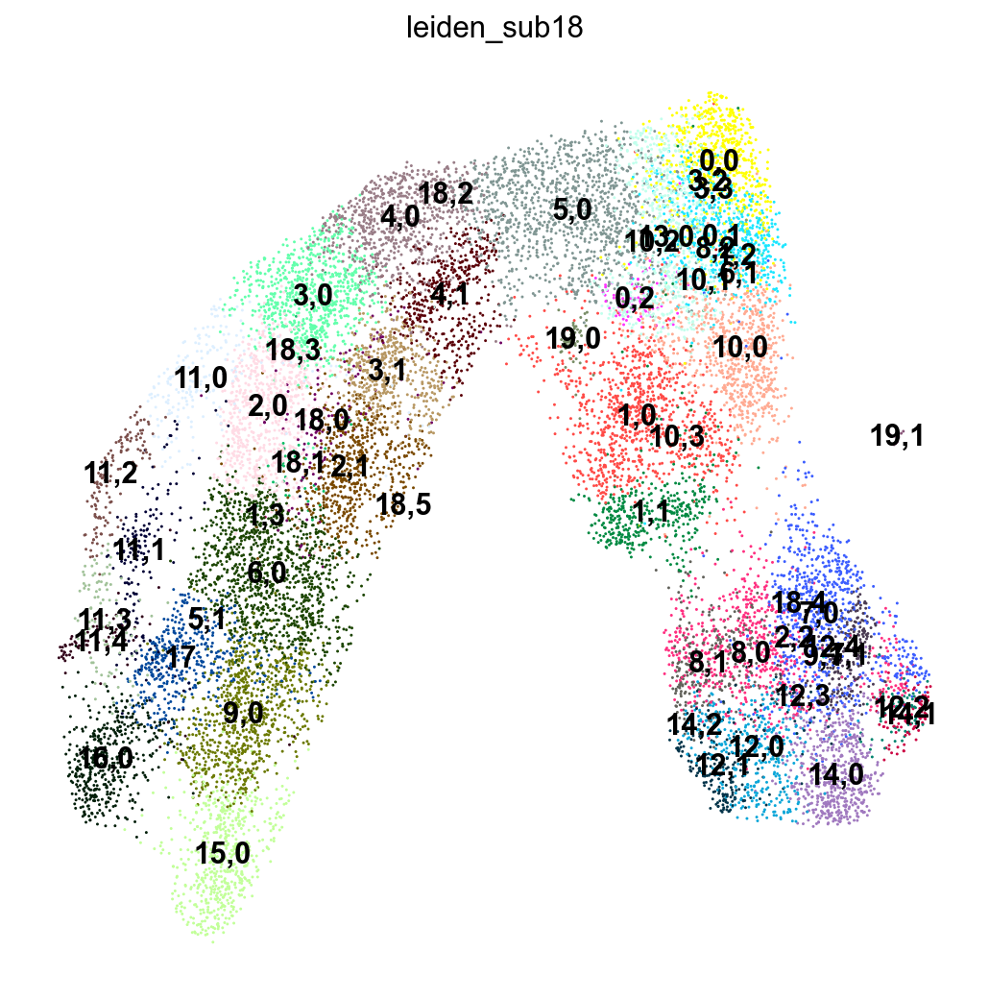

5,0     1176
6,0     1134
1,0      988
9,0      833
3,0      816
4,0      777
7,0      769
2,0      757
10,0     754
0,0      702
13,0     661
0,1      635
2,1      632
8,0      624
15,0     588
14,0     554
3,1      469
16,0     460
4,1      447
17       433
1,1      409
12,0     383
8,1      286
7,1      249
12,1     227
11,0     204
11,1     176
18,0     139
11,2     137
11,3     110
14,1      90
0,2       86
11,4      77
12,2      68
19,0      56
18,1      41
19,1      12
10,3       1
3,2        1
1,2        1
18,5       1
18,4       1
18,3       1
18,2       1
1,3        1
2,2        1
3,3        1
10,2       1
5,1        1
14,2       1
6,1        1
8,2        1
9,1        1
12,4       1
12,3       1
10,1       1
Name: leiden_sub18, dtype: int64

In [75]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_sub18']`
categories: 0,0, 0,1, 0,2, etc.
var_group_labels: Ngn3 High late


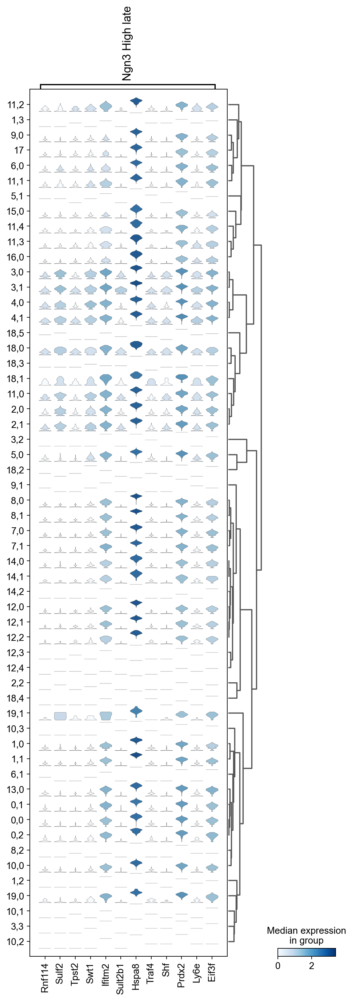

In [76]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Ngn3 High late']
}, groupby=new_key, dendrogram=True)

- 16,0: Alpha

Cluster 17

In [77]:
c_id = 17

In [78]:
init_clus_dict[str(c_id)]

['Fev+ Alpha']

In [79]:
orig_key = 'leiden_sub18'
new_key = 'leiden_sub19' 
new_rg_key = 'rg_sub19'
sub_key = str(c_id)

running Leiden clustering
    finished: found 56 clusters and added
    'leiden_sub19', the cluster labels (adata.obs, categorical) (0:00:00)


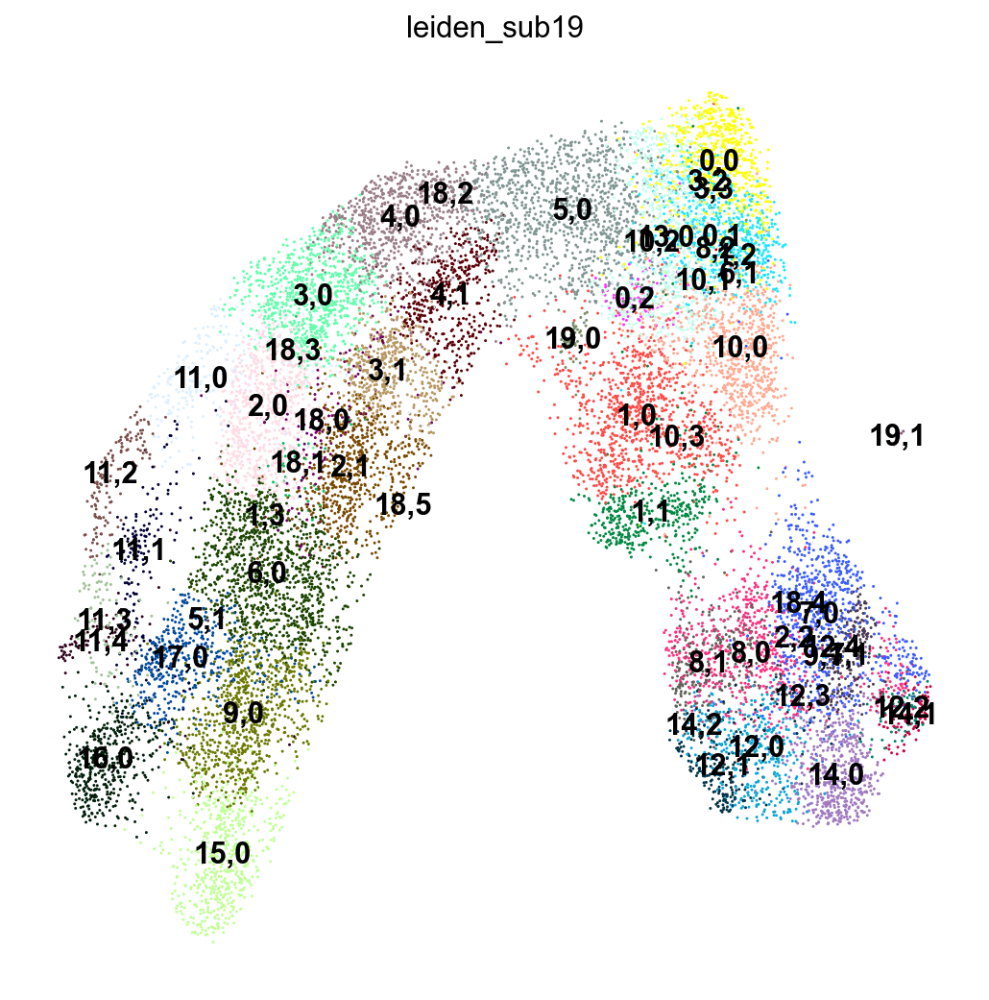

5,0     1176
6,0     1134
1,0      988
9,0      833
3,0      816
4,0      777
7,0      769
2,0      757
10,0     754
0,0      702
13,0     661
0,1      635
2,1      632
8,0      624
15,0     588
14,0     554
3,1      469
16,0     460
4,1      447
17,0     433
1,1      409
12,0     383
8,1      286
7,1      249
12,1     227
11,0     204
11,1     176
18,0     139
11,2     137
11,3     110
14,1      90
0,2       86
11,4      77
12,2      68
19,0      56
18,1      41
19,1      12
10,3       1
3,2        1
1,2        1
18,5       1
18,4       1
18,3       1
18,2       1
1,3        1
2,2        1
3,3        1
10,2       1
5,1        1
14,2       1
6,1        1
8,2        1
9,1        1
12,4       1
12,3       1
10,1       1
Name: leiden_sub19, dtype: int64

In [80]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_sub19']`
categories: 0,0, 0,1, 0,2, etc.
var_group_labels: Fev+ Alpha


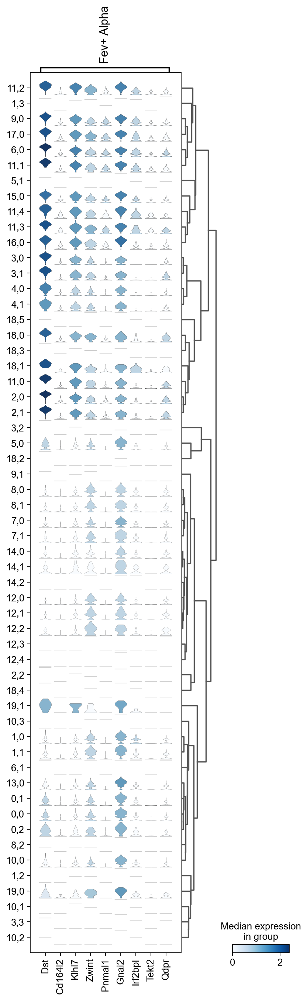

In [81]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Fev+ Alpha']
}, groupby=new_key, dendrogram=True)

- 17,0: Fev+ Alpha

In [82]:
final_leiden = "leiden_sub19"

In [83]:
# note: Multipotent annotations are immature Acinar cells
# note: we do not distinguish between Ngn3 high late and Ngn3 high early

new_cluster_names = {
    
    "0,0": "Ductal",
    "0,1": "Ductal",
    "0,2": "Ductal",
    
    "1,0": "Prlf. Ductal",
    "1,1": "Prlf. Ductal",
    "1,2": "low q",
    "1,3": "low q",
    
    "2,0": "Ngn3 high",
    "2,1": "Ngn3 high",
    "2,2": "low q",
    
    "3,0": "Ngn3 high",
    "3,1": "Ngn3 high",
    "3,2": "low q",
    "3,3": "low q",
    
    "4,0": "Ngn3 high",
    "4,1": "Ngn3 high",
    
    "5,0": "Ngn3 low",
    "5,1": "low q",
    
    "6,0": "Fev+",
    "6,1": "low q",
    
    "7,0": "Imm. Acinar",
    "7,1": "Imm. Acinar",
    
    "8,0": "Imm. Acinar",
    "8,1": "Imm. Acinar",
    "8,2": "low q",
    
    "9,0": "Fev+ Beta",
    "9,1": "low q",
    
    "10,0": "Ductal",
    "10,1": "low q",
    "10,2": "low q",
    "10,3": "low q",
    
    "11,0": "Eps/Delta progenitors",
    "11,1": "Fev+ Delta",
    "11,2": "Epsilon",
    "11,3": "Epsilon",
    "11,4": "Delta",
    
    "12,0": "Mat. Acinar",
    "12,1": "Mat. Acinar",
    "12,2": "Mat. Acinar",
    "12,3": "low q",
    "12,4": "low q",
    
    "13,0": "Ductal",
    
    "14,0": "Mat. Acinar",
    "14,1": "Mat. Acinar",
    "14,2": "low q",
    
    "15,0": "Beta",
    
    "16,0": "Alpha",    
    
    "17,0": "Fev+ Alpha",
    
    "18,0": "Ngn3 high cycling",
    "18,1": "low q",
    "18,2": "low q",
    "18,3": "low q",
    "18,4": "low q",
    "18,5": "low q",
    
    "19,0": "Ductal",
    "19,1": "Ductal",
    
}
ct_column = 'celltype'
adata.obs[ct_column] = adata.obs[final_leiden].astype("str").values
for key in new_cluster_names.keys():
    adata.obs[ct_column][adata.obs[final_leiden]==key] = new_cluster_names[key]
adata.obs[ct_column] = adata.obs[ct_column].astype("category")
#adata.obs.celltype = adata.obs.celltype.cat.rename_categories(new_cluster_names)

/var/folders/nv/23yzkl2x1gd0mhpjqgpm0f4hqc8gvy/T/ipykernel_7340/2444177117.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs[ct_column][adata.obs[final_leiden]==key] = new_cluster_names[key]
/var/folders/nv/23yzkl2x1gd0mhpjqgpm0f4hqc8gvy/T/ipykernel_7340/2444177117.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs[ct_column][adata.obs[final_leiden]==key] = new_cluster_names[key]
/var/folders/nv/23yzkl2x1gd0mhpjqgpm0f4hqc8gvy/T/ipykernel_7340/2444177117.py:86: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https:

In [84]:
[key for key in marker_genes_mouse2.keys() if key in adata.obs[ct_column].cat.categories]

['Mat. Acinar',
 'Ductal',
 'Prlf. Ductal',
 'Fev+ Beta',
 'Beta',
 'Fev+ Alpha',
 'Alpha',
 'Fev+ Delta',
 'Delta',
 'Epsilon']

In [85]:
set(adata.obs[ct_column].cat.categories).difference(set([key for key in marker_genes_mouse2.keys() if key in adata.obs[ct_column].cat.categories]))

{'Eps/Delta progenitors',
 'Fev+',
 'Imm. Acinar',
 'Ngn3 high',
 'Ngn3 high cycling',
 'Ngn3 low',
 'low q'}

In [86]:
adata.obs["celltype"].value_counts()

Ngn3 high                3898
Ductal                   2906
Imm. Acinar              1928
Prlf. Ductal             1397
Mat. Acinar              1322
Ngn3 low                 1176
Fev+                     1134
Fev+ Beta                 833
Beta                      588
Alpha                     460
Fev+ Alpha                433
Epsilon                   247
Eps/Delta progenitors     204
Fev+ Delta                176
Ngn3 high cycling         139
Delta                      77
low q                      60
Name: celltype, dtype: int64

In [87]:
adata = adata[~(adata.obs["celltype"] == "low q")]

/Users/dominik.klein/opt/anaconda3/envs/mm_best_muon_full/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/Users/dominik.klein/opt/anaconda3/envs/mm_best_muon_full/lib/python3.9/contextlib.py:126: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  next(self.gen)


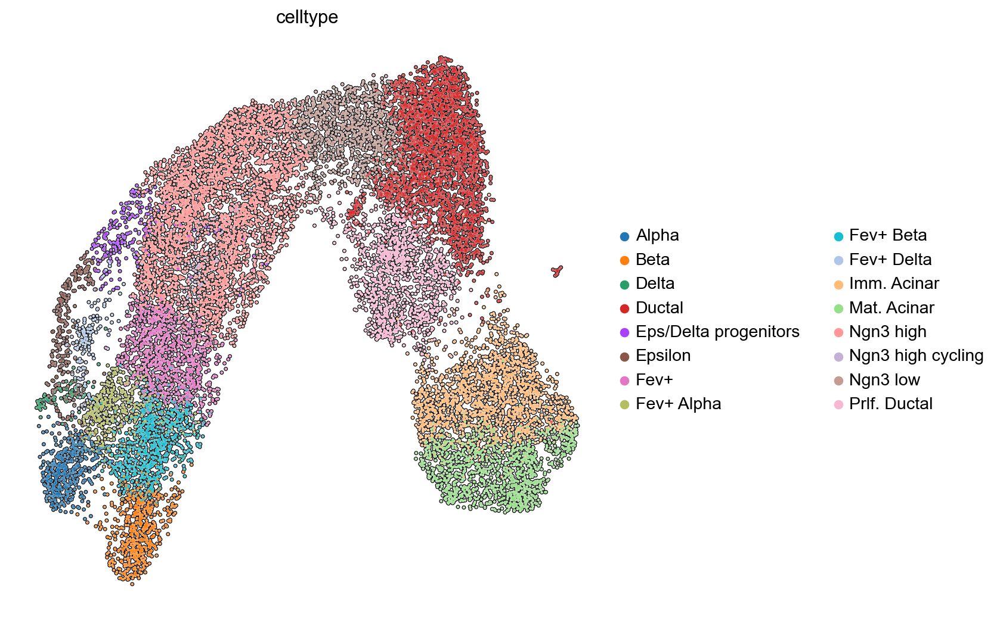

In [88]:
sc.pl.umap(adata, color=ct_column, size=15, add_outline=True, alpha=0.7, outline_width=(0.3, 0.0), color_map=ch_YlRd)

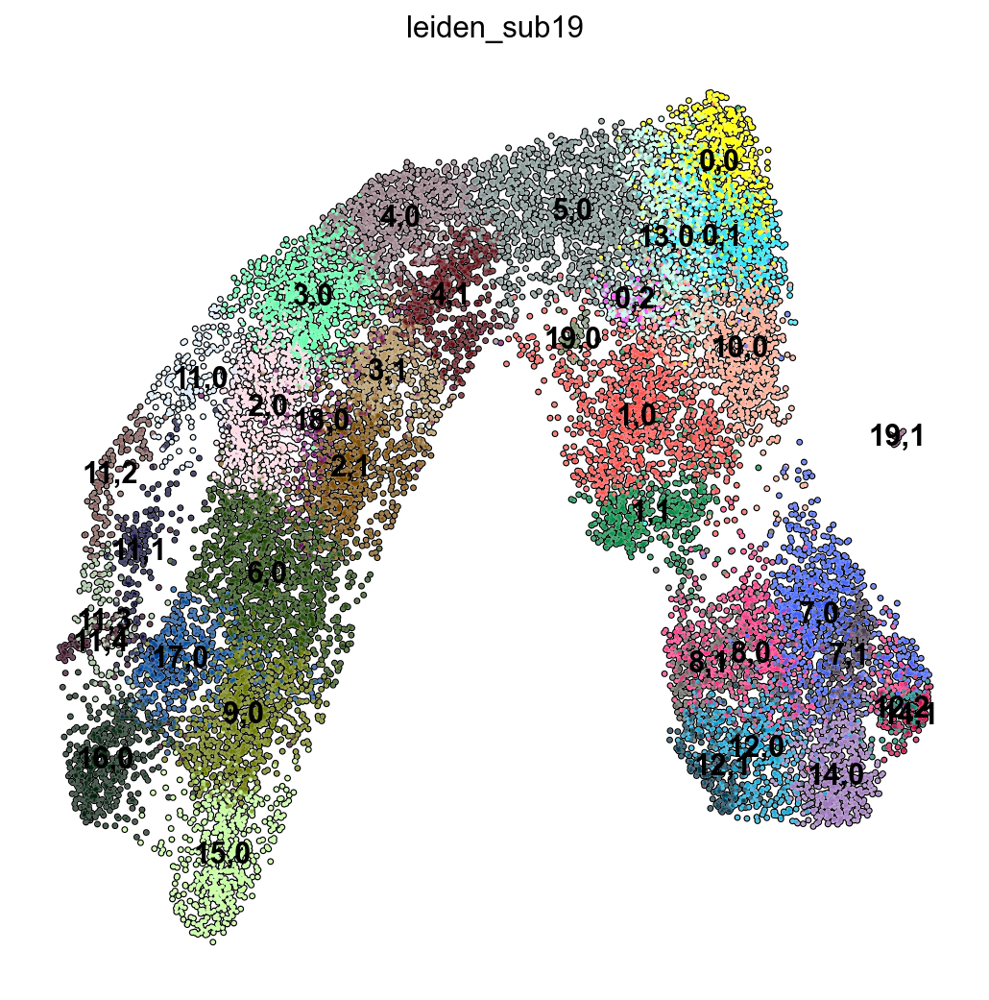

In [89]:
sc.pl.umap(adata, color=final_leiden, legend_loc="on data", size=15, add_outline=True, alpha=0.7, outline_width=(0.3, 0.0), color_map=ch_YlRd)

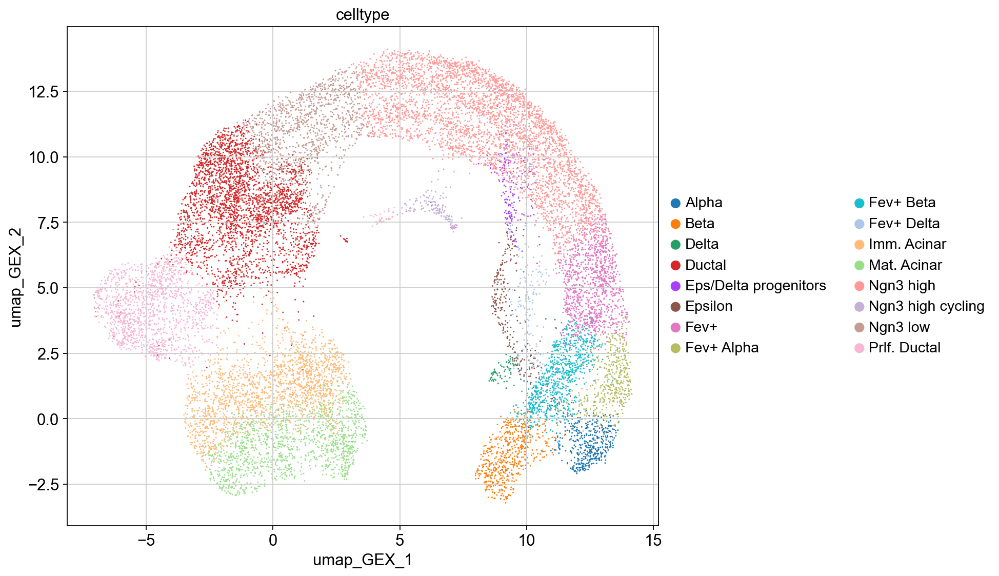

In [90]:
sc.pl.scatter(adata, x="umap_GEX_1", y="umap_GEX_2", color=ct_column)

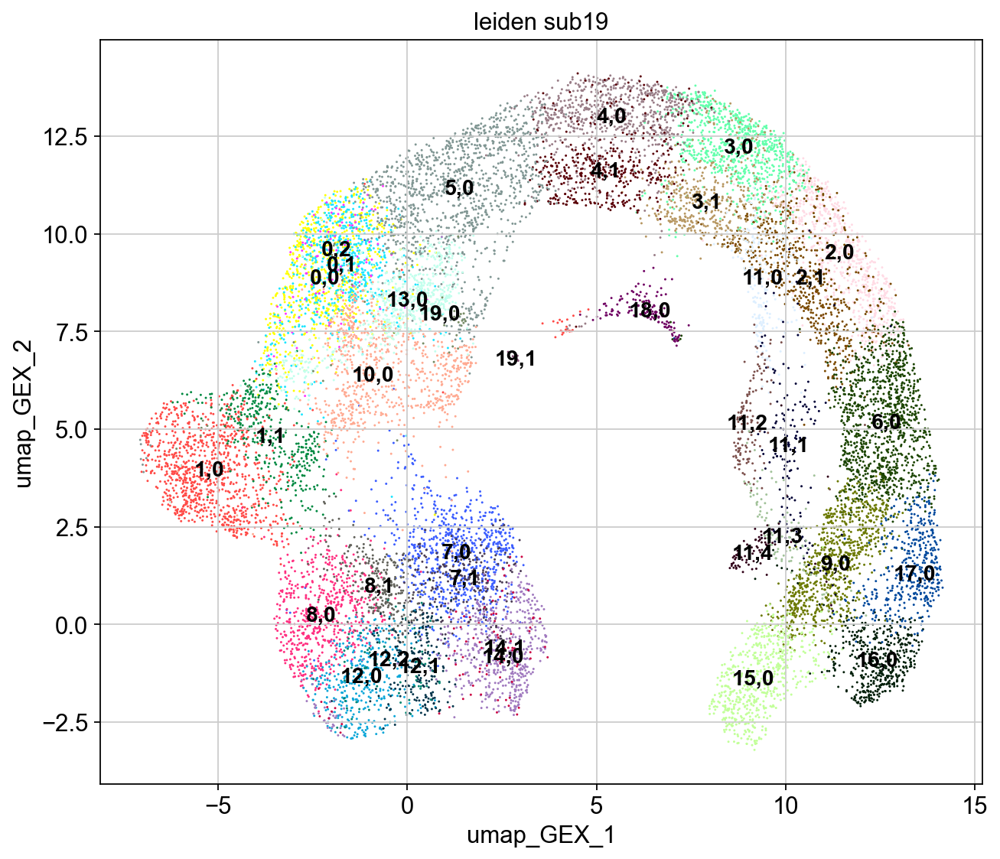

In [91]:
sc.pl.scatter(adata, x="umap_GEX_1", y="umap_GEX_2", color=final_leiden, legend_loc="on data")

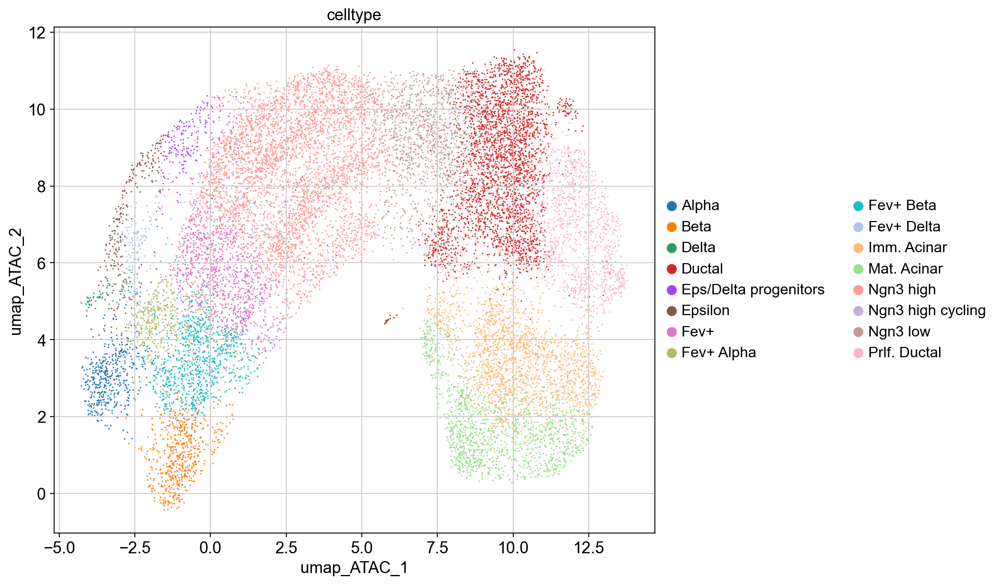

In [92]:
sc.pl.scatter(adata, x="umap_ATAC_1", y="umap_ATAC_2", color=ct_column)

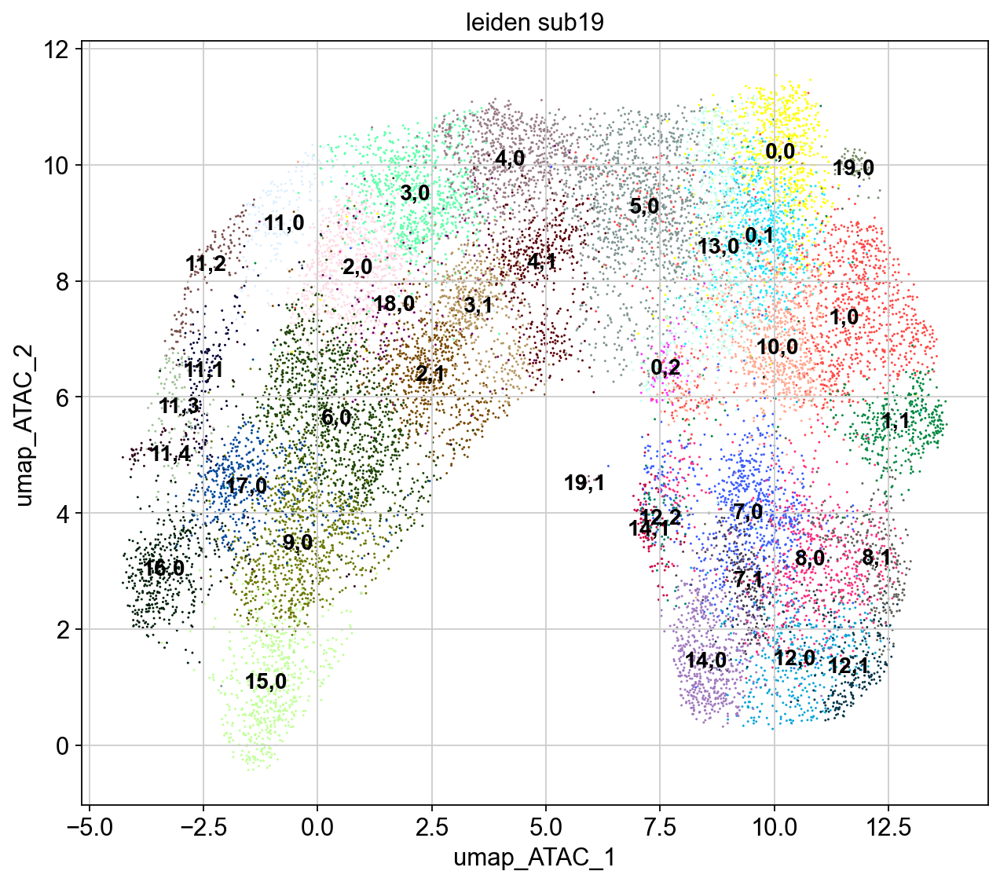

In [93]:
sc.pl.scatter(adata, x="umap_ATAC_1", y="umap_ATAC_2", color=final_leiden, legend_loc="on data")

In [94]:
x,y = 'sample', 'celltype'
df = adata.obs.copy()
df1 = df.groupby(x)[y].value_counts(normalize=True)
df1 = df1.mul(100)
df1 = df1.rename('percent').reset_index()

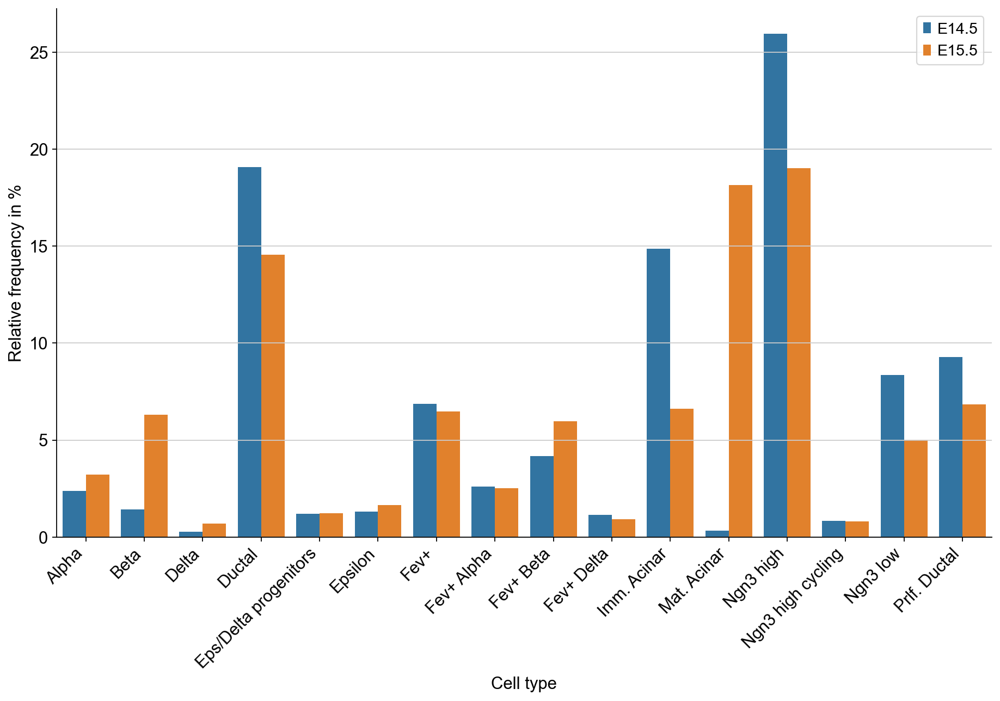

In [95]:
import seaborn as sns

g = sns.catplot(x="level_1",y='percent',hue=x,kind='bar',data=df1, legend=False,height=8.27, aspect=11.7/8.27)
plt.xlabel("Cell type")
plt.ylabel("Relative frequency in %")
plt.xticks(rotation=45, ha='right')
plt.legend(loc='upper right')
plt.tight_layout()


In [96]:
x,y = 'sample', 'celltype'
df2 = adata[~adata.obs["celltype"].isin(["Mat. Acinar", "Imm. Acinar", "Ductal", "Prlf. Ductal"])].obs.copy()
df3 = df2.groupby(x)[y].value_counts(normalize=True)
df3 = df3.mul(100)
df3 = df3.rename('percent').reset_index()

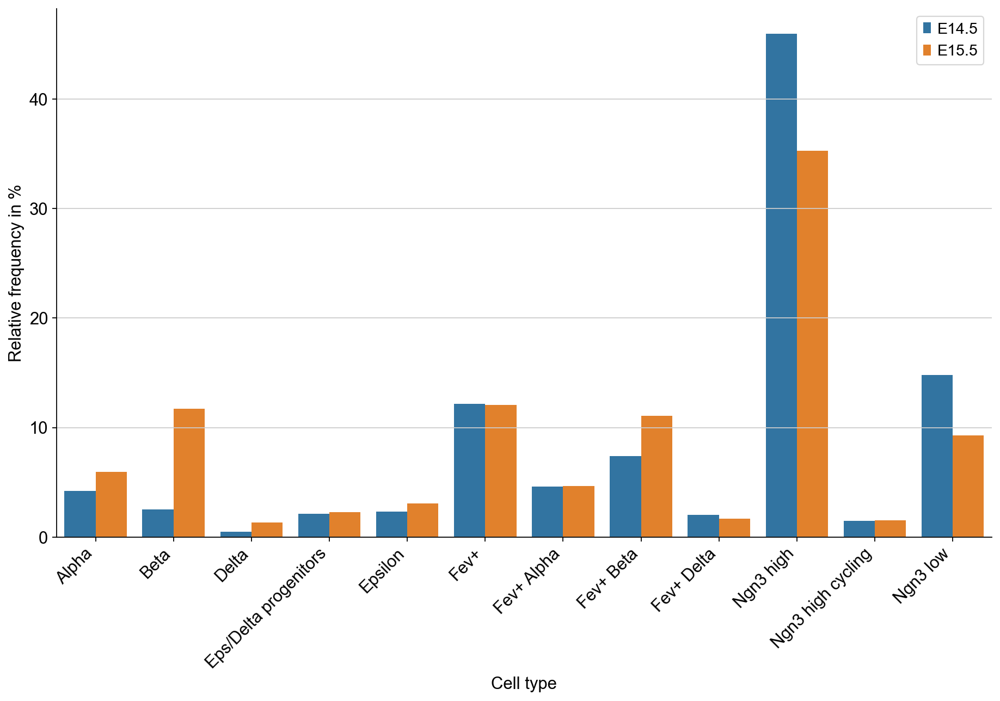

In [97]:
g = sns.catplot(x="level_1",y='percent',hue=x,kind='bar',data=df3, legend=False,height=8.27, aspect=11.7/8.27)
plt.xlabel("Cell type")
plt.ylabel("Relative frequency in %")
plt.xticks(rotation=45, ha='right')
plt.legend(loc='upper right')
plt.tight_layout()

In [98]:
adata.obsm["X_umap_ATAC"] = adata.obsm["umap_ATAC"]
adata.obsm["X_umap_GEX"] = adata.obsm["umap_GEX"]

In [99]:
adata

AnnData object with n_obs × n_vars = 16918 × 14663
    obs: 'n_counts', 'sample', 'int_id', 'reporter', 'log_cell_probs', 'cell_barcodes_du', 'cell_barcodes_cr', 'cell_barcodes', 'log_counts', 'n_genes', 'log_genes', 'mt_frac', 'rp_frac', 'ambi_frac', 'total_counts_rank', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'leiden', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS.enrichment', 'TSS.percentile', 'log_nCount_ATAC', 'log_nFeature_ATAC', 'scrublet_scores', 'scrublet_doublets', 'scrublet_doublets_cat', 'dd_doublets', 'dd_scores', 'dd_log_p_values', 'dd_voting_average', 'dd_-log_p_values', 'dd_doublets_cat', 'pANN', 'DF_classifications_1', 'DF_classifications_2', 'pANN_SCT', 'DF_SCT_classifications_1', 'DF_SCT_classifications_2', 'df_doublets',

In [100]:
# Save
sc.write('/Users/dominik.klein/data/E14-E15_adata_filtered_rmDoublets_sctNormalized_WNN_embedded_initialAnno_new_annotation.h5ad', adata)